# Evaluating Consistency of Clustering Algorithms on Time Series Data

In [4]:
import os
import csv
import math
from zipfile import ZipFile
# Local clustering class with a bunch of methods
from numpy.ma.core import nonzero
os.chdir("/scratch/nick/MSMC-Curve-Analysis")
# Data thingy libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as snsariTesting

from tslearn.generators import random_walks
import matplotlib.cm as cm
import json 
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import kneed
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_samples
from sklearn.metrics import adjusted_rand_score
# from sklearn.metrics import silhouette_score
from tslearn.clustering import silhouette_score

from MSMC_clustering import Msmc_clustering
import MSMC_clustering as mc
import Silhouette_analysis as sa

# Load in precomputed list of files to filter out (Saves time)
# Consider making the sharpness filter on percent too
regular_path = "lenient-curve-filter"
filter_path = "MSMC-Exploratory-Analysis/results/figures/filtered-out-curves"
kept_path = "MSMC-Exploratory-Analysis/results/figures/kept-curves"

omit_list_path = "MSMC-Exploratory-Analysis/results/lists"
omit_test_lenient_file = "omit_test_lenient.txt"
kept_test_lenient_file = "kept_test_lenient.txt"

if omit_test_lenient_file not in os.listdir(omit_list_path):
    omit_test_lenient = filter_flattness_sharpness(cluster_rt, 
                        identical_val_threshold = 0.7, err = 0.01, # Args for filtering flattness
                        magnitude_jump_threshold = 0.95, points_per_jump = 3, # Args for filtering magnitude jumps
                        plot = True, min_unique_vals=999, ignore_low_mag=0, 
                        fs_x=10, fs_y=9, save_to_filter=filter_path, save_to_kept=kept_path) # These are some pretty good settings
    with open(omit_list_path+"/"+omit_test_lenient_file, "w") as myFile:
        for fileName in omit_test_lenient:
            myFile.write(f"{fileName}\n")

else: # If list exists
    omit_test_lenient = [] # List of names to files which were filtered out due to being elboq shaped
    with open(omit_list_path+"/"+omit_test_lenient_file, "r") as myFile:
        for line in myFile:
            omit_test_lenient.append(line.rstrip())

kept_test_lenient = [] # List of names to files which were kept
for jpg_name in os.listdir(kept_path):
    jpg_name = jpg_name[:-4] # assuming that all files in "kept_path" are .jpgs and end with the specifier ".jpg"
    kept_test_lenient.append(jpg_name)

# List of latin names is useful for indexing on metadata dfs later on
omit_test_lenient_latin = [name[:name.index("_GC")] for name in omit_test_lenient] 
kept_test_lenient_latin = [name[:name.index("_GC")] for name in kept_test_lenient]


# Rand Index & Point Cluster Tracking Tests

- I did a grid search over gamma, cluster numbers, and seeds
- I also tracked where points tended to move between a constant clustering seed
and variable clustering seeds.

In [122]:
import pickle
from sklearn.metrics import adjusted_rand_score

def writeList(save_to, inlist):
    with open(save_to, "w") as f:
        for x in inlist:
            f.write(x+"\n")
    return
            
def readList(path):
    with open(path, "r") as f:
        output = []
        for x in f:
            x = x.rstrip("\n")
            output.append(x)
    return output

def label2subtable(table, label):
    res = table[table["Labels"]==label]
    return res

def ARI_consistency_test(algo: "str",
                         to_omit: "list<str>",
                         iters: "int",
                         gammas: "list<int>",
                         clusts: "list<int>",
                         oldSeed: "int",
                         newSeeds: "list<int>",
                         save_to: "bool/str"=False,
                         plot_everything: "bool"=False,
                         )->"dict":
    '''
    [!] DOES A LOT OF MSMC TS CLUSTERING
    Does pairwise comparisons between a reference clustering (using oldSeed)
    and various other clusterings (using newSeeds). Includes option of taking
    in list of sample names (full file name of sample) as items to omit.
    
    Clusterings can be done over a range of gammas (if using softdtw) and over
    a range of manual clustering sizes
    '''
    seeds=newSeeds
    by_gamma_dict = dict() # Contains [old_seed_dict, new_seed_dict, randi_dict]
    for gamma in gammas:
        old_seed_dict = {clust : [] for clust in clusts}
        new_seed_dict = {clust : [] for clust in clusts}
        randi_dict =    {clust : [] for clust in clusts}
        new_clusters = {clust : dict() for clust in clusts}
        old_clusters = {clust : dict() for clust in clusts}
        for clust in clusts:
            cluster_rt_norm_lenient_og = Msmc_clustering(directory="msmc_curve_data/", 
                                                         mu=1.4e-9, 
                                                         generation_time_path='generation_lengths/', 
                                                         real_time=True, 
                                                         to_omit=to_omit,
                                                         normalize_lambda=True, 
                                                         log_scale_time=True, 
                                                         plot_on_log_scale=True, 
                                                         exclude_subdirs=["Archive", "mammals_part_1"], 
                                                         manual_cluster_count=clust,
                                                         algo=algo) # cluster count by sqrt method is 14
            cluster_rt_norm_lenient_og.cluster_curves(omit_front=0, 
                                                      omit_back=0, 
                                                      cols=4,  
                                                      fs_x=60, 
                                                      fs_y=30,
                                                      metric_params={"gamma" : gamma},
                                                      metric="softdtw",
                                                      random_state=oldSeed,
                                                      plot_everything=plot_everything,
                                                      iter=iters)
            for seed in seeds:
                cluster_rt_norm_lenient = Msmc_clustering(directory="msmc_curve_data/", 
                                                        mu=1.4e-9, 
                                                        generation_time_path='generation_lengths/', 
                                                        real_time=True, 
                                                        to_omit=to_omit,
                                                        normalize_lambda=True, 
                                                        log_scale_time=True, 
                                                        plot_on_log_scale=True, 
                                                        exclude_subdirs=["Archive", "mammals_part_1"], 
                                                        manual_cluster_count=clust,
                                                        algo=algo) # cluster count by sqrt method is 14

                cluster_rt_norm_lenient.cluster_curves(omit_front=0, 
                                                       omit_back=0, 
                                                       cols=4,  
                                                       fs_x=60, 
                                                       fs_y=30,
                                                       metric_params={"gamma" : gamma},
                                                       metric="softdtw",
                                                       random_state=seed,
                                                       plot_everything=plot_everything,
                                                       iter=iters)

                old = cluster_rt_norm_lenient_og.dtw_labels
                old_seed_dict[clust].append(old)

                new = cluster_rt_norm_lenient.dtw_labels
                new_seed_dict[clust].append(new)
                randi_dict[clust].append(adjusted_rand_score(old, new))
                new_clusters[clust][seed] = cluster_rt_norm_lenient
                print(f"[RAND INDEX]: Random seed comparison of {clust} clusters: {adjusted_rand_score(old, new)}")
            old_clusters[clust][oldSeed] = cluster_rt_norm_lenient_og
        by_gamma_dict[gamma] = [old_seed_dict, new_seed_dict, randi_dict, old_clusters, new_clusters]
        if save_to:
            pickle.dump(by_gamma_dict, open(save_to, 'wb'))
    return by_gamma_dict

def badVoteCounter(ARI_consistency_test_dict: "dict",
                   clust: "int",
                   oldSeed: "int",
                   newSeeds: "list<int>",
                   gamma=0.0,
                   savefig_to=False,
                   savepkl_to=False,
                   plot_everything: "bool"=False)->"dict":
    '''
    I have seriesDict which is {name: series}

    We have a constant clustering and compare it to N number of random clusterings.

    I will need to separate samples by cluster.
    I add votes to samples for each difference that their constant clustering has
    with each new clustering.

    For each sample in old cluster
        Find clustermates of old sample
        For same sample in new cluster
            Find clustermates of old sample in new cluster
            Count the number of differences between old and new cluster
            Map count of differences to sample name
    '''
    seeds = newSeeds
    old_clusters = ARI_consistency_test_dict[gamma][-2]
    new_clusters = ARI_consistency_test_dict[gamma][-1]
    old = old_clusters[clust][oldSeed]
    oldSampleNames = old.namesofMySeries
    badVoteCount = {sample: 0 for sample in oldSampleNames}
    for oldSampleName in oldSampleNames:
        oldSampleKey = oldSampleName[:oldSampleName.index("_GC")] # Latin name
        oldSampleLabel = old.clusterTable.loc[oldSampleKey]["Labels"]
        oldMates = label2subtable(old.clusterTable, oldSampleLabel) # Clustermates of old sample

        for seed in seeds:
            new = new_clusters[clust][seed]
            newSampleNames = new.namesofMySeries
            newSampleLabel = new.clusterTable.loc[oldSampleKey]["Labels"] # w cluster assignment of old sample
            newMates = label2subtable(new.clusterTable, newSampleLabel)

            difference = list(set(newMates.index) - set(oldMates.index))
            badVoteCount[oldSampleName] += len(difference)
    if plot_everything:
        x, y = zip(*sorted(list(badVoteCount.items()), key = lambda x:x[1]))
        fig = plt.figure(figsize = (40, 40))
        plt.barh(x, y)
        plt.title("Incremental Votes for Samples")
        plt.xlabel("Votes")
        plt.ylabel("Samples")
    if savefig_to and savepkl_to:
        plt.savefig(savefig_to)
        pickle.dump(badVoteCount, open(savepkl_to, 'wb'))
    return badVoteCount

def voteOutMovingSample(toAddDict: "dict",
                        badVoteCount: "dict",
                        lower_cutoff: "float" = 0.0,
                        cutoff_last: "bool/int" = False,
                        save_to: "str"=False,
                        accumulate: "bool" = False,
                        both=False)-> "list":
    '''
    toAddDict: like badVoteCount dict but this will be something you want to 
               add to and eventually return at the end of the function. The
               idea is to accumulate votes into this dict.
               
    badVoteCount: {sample_name : votes for being the worst in a clustering}
    
    both: Acts as a flag which will determine if you do both things
    
    Returns either a list of samples to omit or a dict acting as a frequency
    counter for each sample.
    
    Instead of cutting off the last {cutoff_last} number of points (ones with
    the most votes) we accumulate votes in a dict and use some other param to
    cutoff some number of points from the dict (also cutting off the ones with
    the most votes). This might do something different... 
    '''
    # Sort vote dict items by votes (bad samples have many votes)
    if both:
        accumulate = False
    if not accumulate:
        x, y = zip(*sorted(list(badVoteCount.items()), key = lambda x:x[1]))
        y = np.array(y)
        if cutoff_last:
            newOmit = list(x[-cutoff_last:])
        else:
            newOmit = list(x[-len(y[y>lower_cutoff]):]) # Samples with more votes
        newOmit = list(set(newOmit))
        if save_to:
            writeList(save_to, newOmit)
        if not both:
            return newOmit # List of samples to cutoff/omit due to high votes
    if accumulate or both:
        if len(toAddDict.items()) == 0:
            toAddDict = badVoteCount.copy()
        else:
            toAddDict = toAddDict.copy()
            for item in badVoteCount.items():
                sample, votes = item
                toAddDict[sample] += votes
        if not both:
            return toAddDict # Hist of samples and their badVotes
    return [newOmit, toAddDict] # Return both thingies

'''
Reliability testing: now a script on mermaid (ariTesting.py)
(MAKE ANOTHER SCIRPT)

REWORK: This uses accumulateVotes function which replaces voteOutMovingSample. 
Doing this makes it so that you don't remove samples with every
oldSeed, newSeed comparison. Instead you accumulate votes over all comparisons
and cutoff some number of the worst votes at the end.
'''

def findVotedOutSamples(path,
                        algo,
                        iters,
                        gammas,
                        clusts,
                        oldSeeds,
                        seedsList,
                        cutoff_last,
                        cutoff_lastAccumulated,
                        finalOmits,
                        finalOmitsAccumulated,
                        accumulate,
                        bothIncrementalAccumulative,
                        plot_everything,
                        save_accumulation_fig_to,
                        save_all=True):
    '''
    save_accumulation_fig_to - FIGURE OUT A SUBDIR THAT THIS CAN GO INTO WHEN 
                               SCRIPTIFYING THIS THANG
    
    Essentially appends samples to finalOmits/finalOmitsAccumulated. If either
    of these are empty lists, output should just be a list of voted-out samples
    since nothing was given to start off.
    
    Basically a main function that calls on:
    - ARI_consistency_test: Does this to do pairwise clustering comparisons
    - badVoteCounter: Using samples and labels found with ARI_consistency_test,
                      perform badVote counts and return a histogram-like dict
                      containing votes for each sample
    - voteOutMovingSample: This depends on bothIncrementalAccumulative and accumulate
        If not accumulate and not both: (Incremental)
            Returns a list of samples to omit based on incremental cutoff on votes
        If accumulate and not both: (Accumulative)
            toAddDict will be fed into function, have votes added to it for this
            iteration/increment, then return toAddDict for the next iteration.
        If Both:
            Does both Incremental and Accumulative stuff
            
    After calling these functions, return a pair of lists. First list will 
    correspond to the incremental method of voting out samples. Second list
    will correspond to the accumulative method of voting out samples.
    '''
    
    if bothIncrementalAccumulative: # Perform both types of voting
        accumulate = False
    both=bothIncrementalAccumulative # Pseudonym for bothIncrementalAccumulative
    toAddDict = dict()
    for idx, oldSeed in enumerate(oldSeeds):
        seeds = seedsList[idx]
        ARI_test_dict_path = path + f"ARI_test_dict_oldSeed{oldSeed}.pkl"
        ARI_consistency_test_dict = ARI_consistency_test(algo="kmeans",
                                                         to_omit=omit_test_lenient,
                                                         iters=50,
                                                         gammas=gammas,
                                                         clusts=clusts,
                                                         oldSeed=oldSeed,
                                                         newSeeds=seeds,
                                                         save_to=ARI_test_dict_path,
                                                         plot_everything=plot_everything)
        badVoteCount_path = path + f"badVote_oldSeed{oldSeed}.pkl"
        badVoteCountFig_path = path + f"badVoteFig_oldSeed{oldSeed}.png"
        clust = clusts[0]
        badVoteCount = badVoteCounter(ARI_consistency_test_dict,
                                      clust,
                                      oldSeed,
                                      seeds,
                                      gamma=gamma,
                                      savefig_to=badVoteCountFig_path,
                                      savepkl_to=badVoteCount_path,
                                      plot_everything=plot_everything)
        if save_all:
            save_to = False
        else: 
            save_to = path + f"additionalOmissions/finalARIomits_oldSeed{oldSeed}.txt"
        if not accumulate and not both:
            newOmit = voteOutMovingSample(toAddDict=toAddDict,
                                          badVoteCount=badVoteCount,
                                          cutoff_last=cutoff_last,
                                          save_to=save_to)
            finalOmits += newOmit
        elif accumulate and not both:
            toAddDict = voteOutMovingSample(toAddDict=toAddDict,
                                            badVoteCount=badVoteCount,
                                            accumulate=accumulate)
        elif both:
            pair = voteOutMovingSample(toAddDict=toAddDict,
                                       badVoteCount=badVoteCount,
                                       cutoff_last=cutoff_last,
                                       save_to=save_to,
                                       both=both)
            newOmit, toAddDict = pair
            finalOmits += newOmit
    if accumulate or both:
        x, y = zip(*sorted(list(toAddDict.items()), key=lambda x:x[1]))
        if plot_everything:
            fig = plt.figure(figsize = (40, 40))
            plt.title("Accumulated Votes for Samples")
            plt.xlabel("Votes")
            plt.ylabel("Samples")
            plt.barh(x, y, color="orange")
            plt.show()
            if save_accumulation_fig_to:
                plt.savefig(save_accumulation_fig_to)
            plt.close()
                
        finalOmitsAccumulated += x[-cutoff_lastAccumulated:]
        if not both:
            return ([], finalOmitsAccumulated)
        if both:
            return (finalOmits, finalOmitsAccumulated)
    if not accumulate:
        return (finalOmits, [])

fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


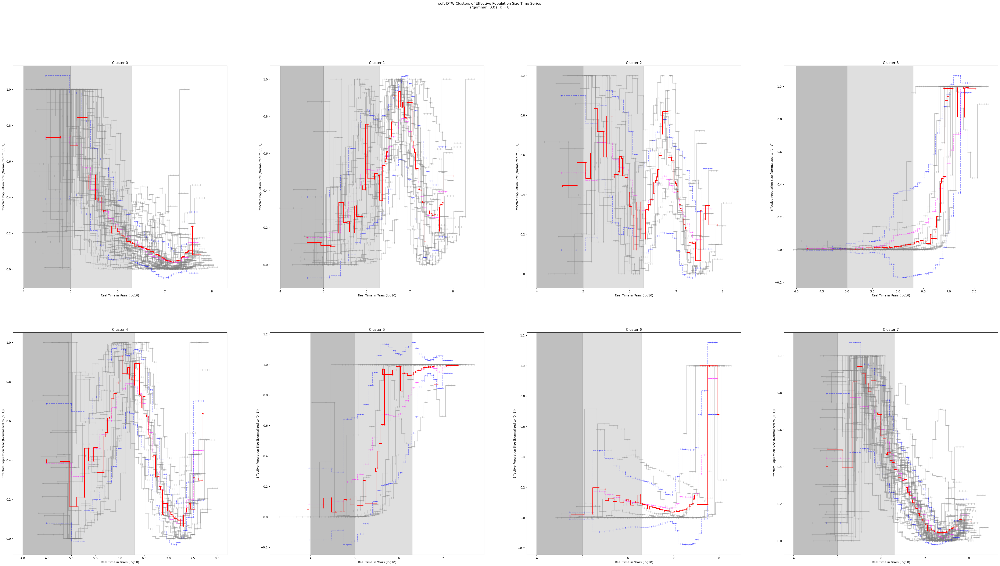

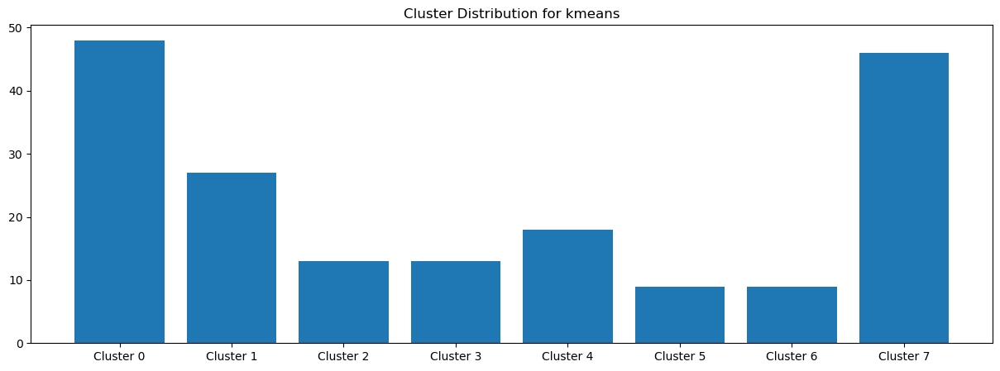

fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


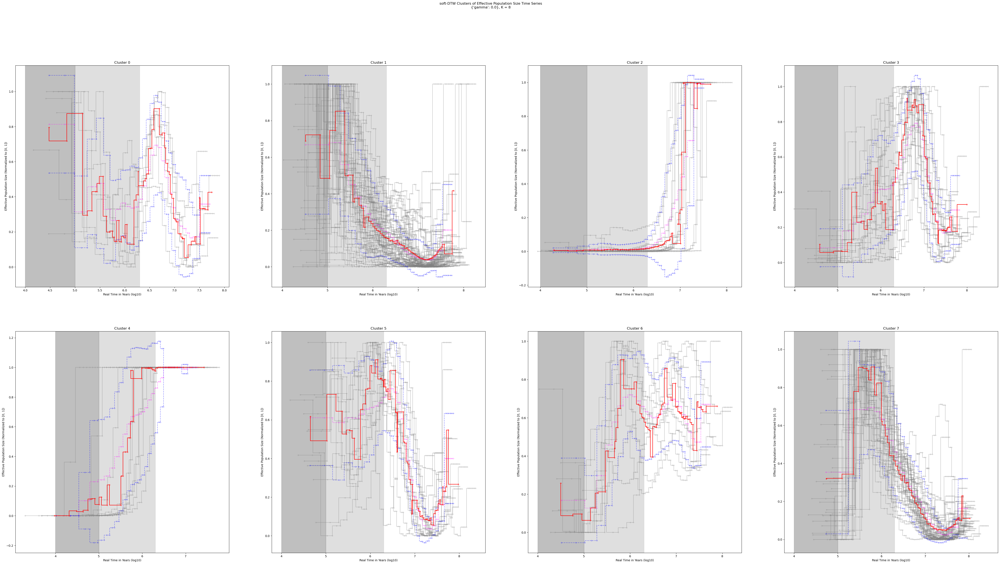

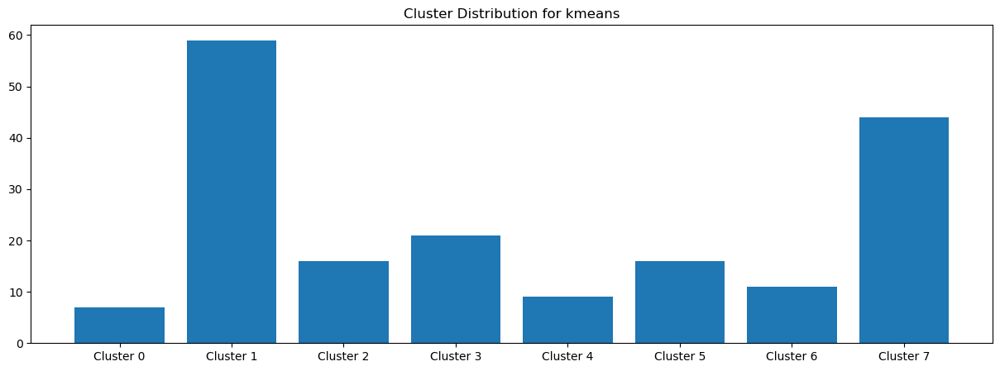

[RAND INDEX]: Random seed comparison of 8 clusters: 0.6540403166051507
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


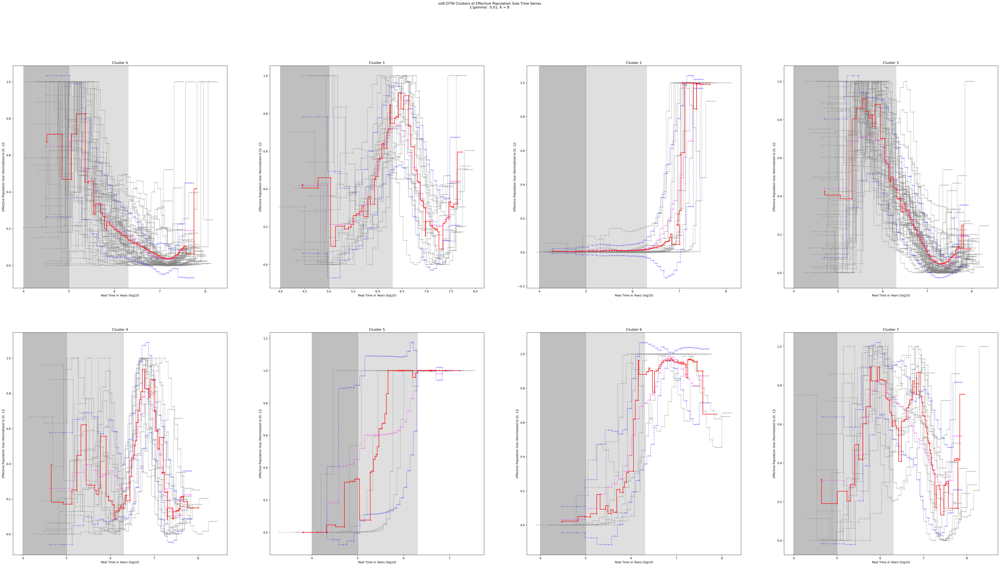

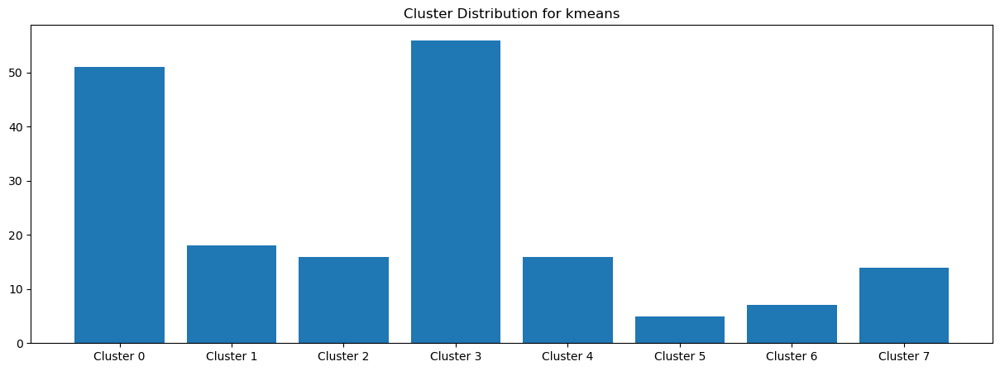

[RAND INDEX]: Random seed comparison of 8 clusters: 0.6256321486628573
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


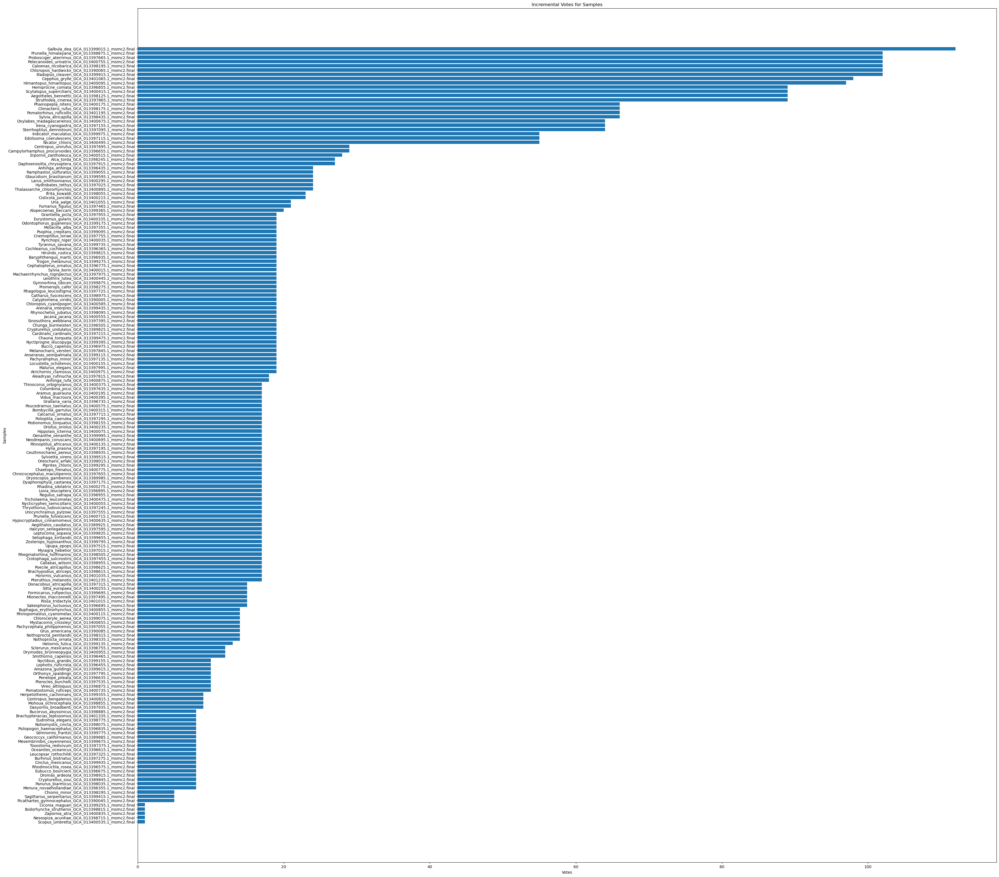

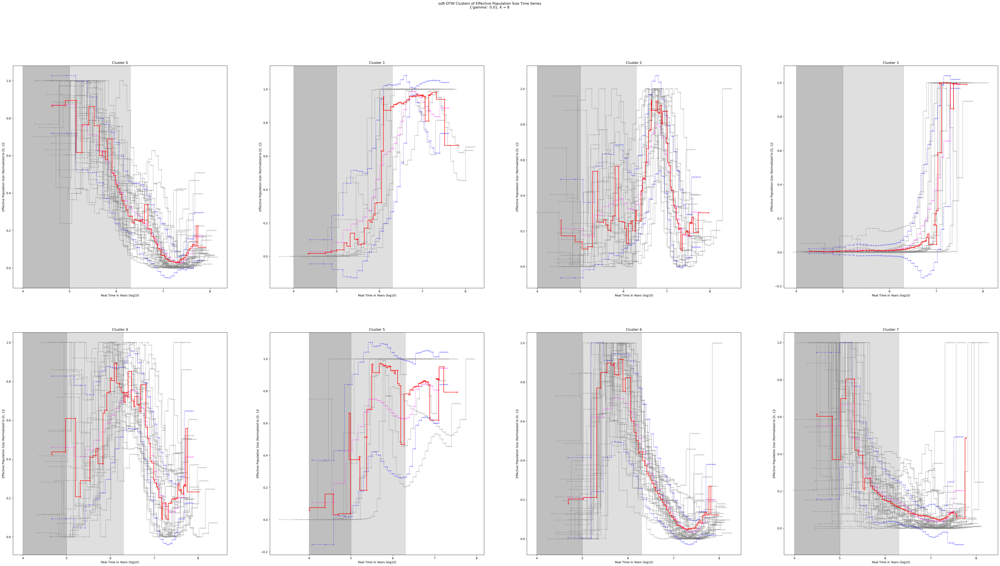

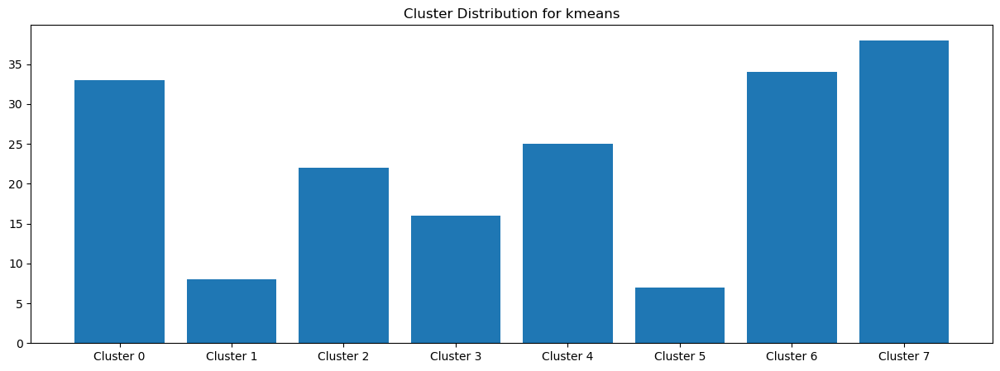

fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


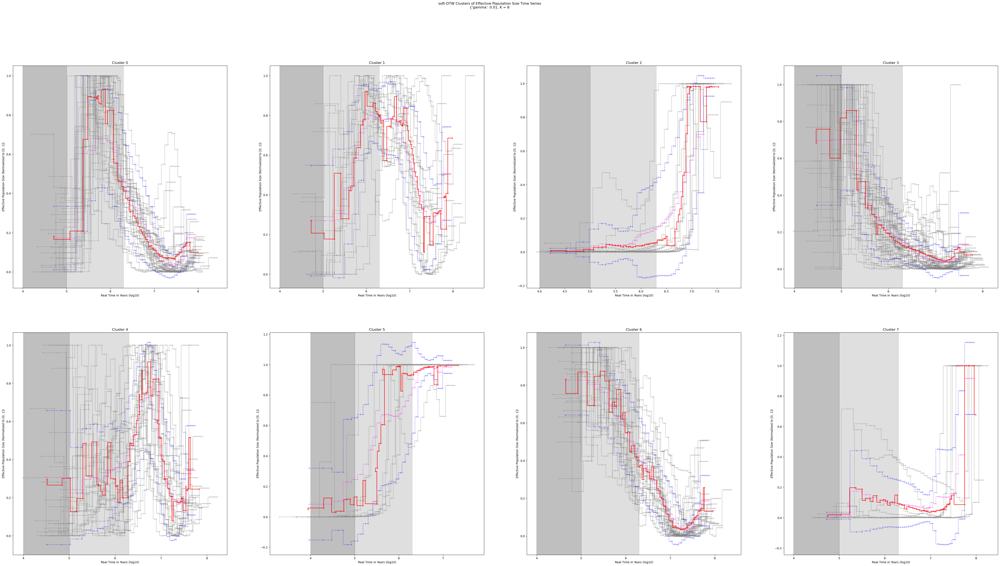

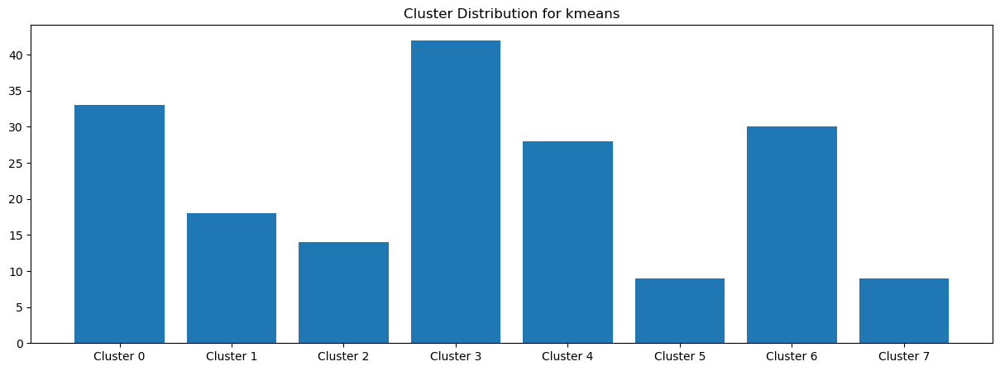

[RAND INDEX]: Random seed comparison of 8 clusters: 0.5733483020991363
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


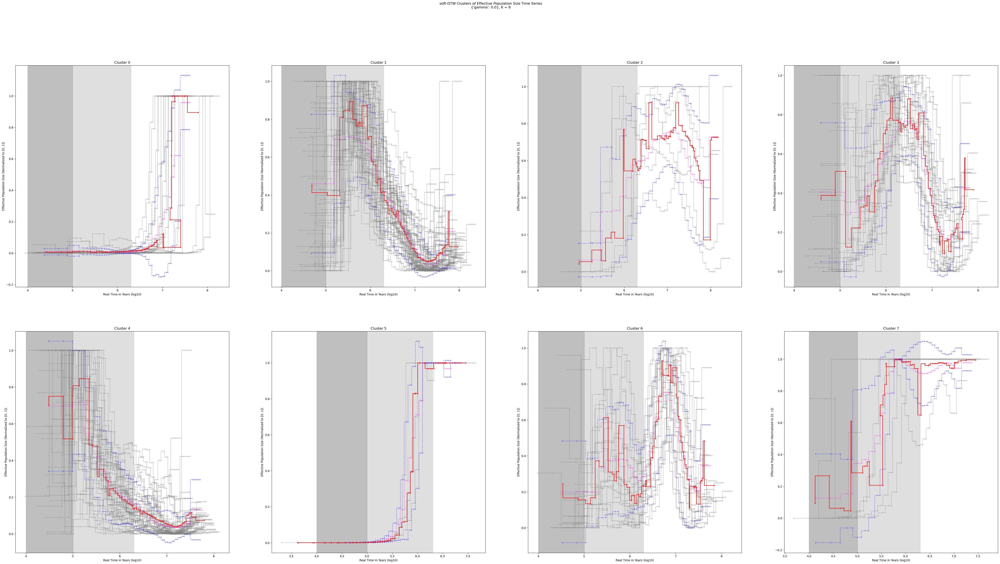

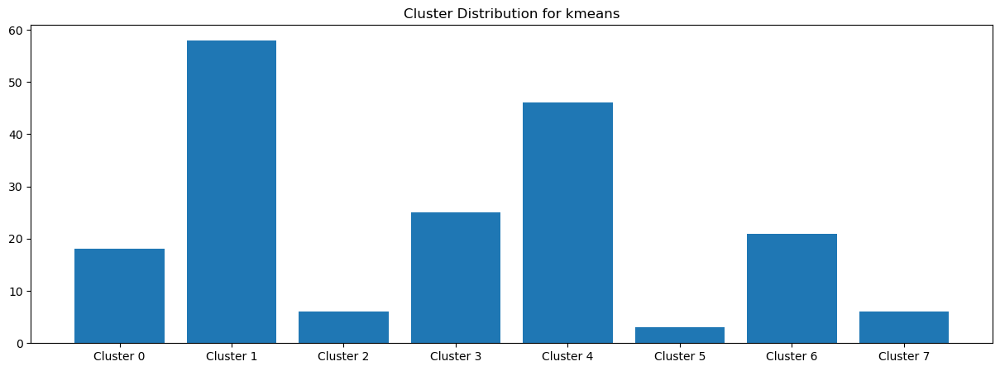

[RAND INDEX]: Random seed comparison of 8 clusters: 0.5751784245534589


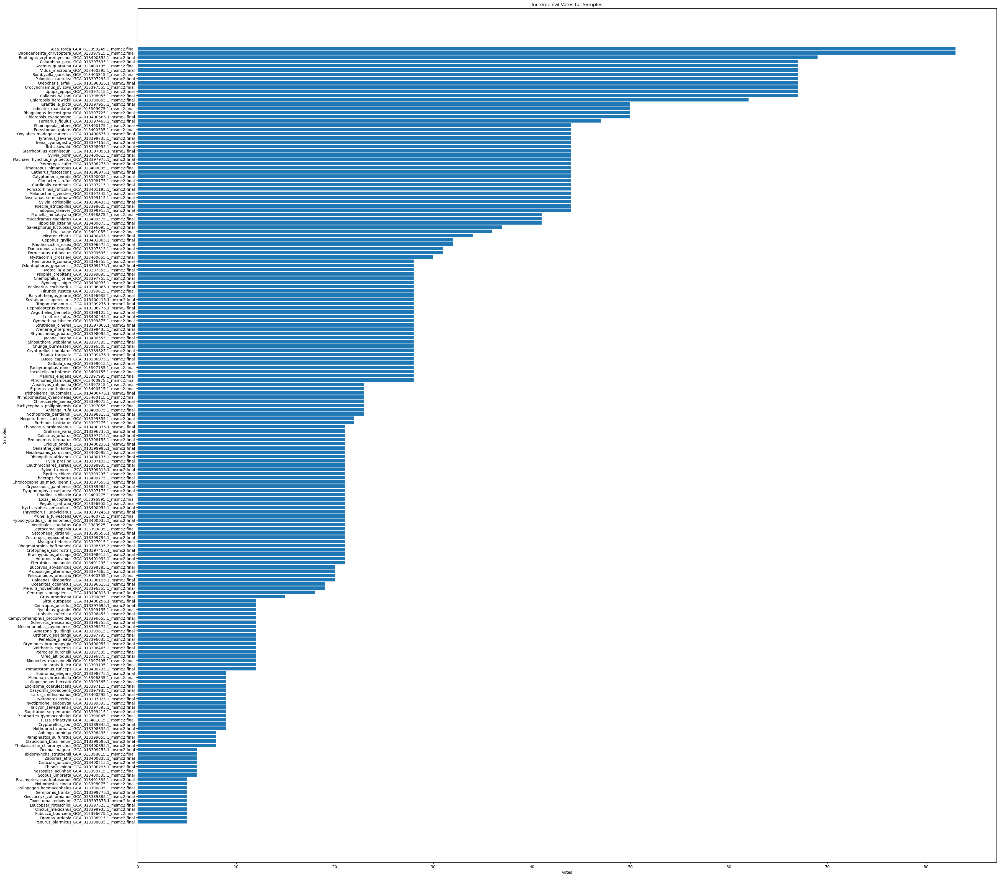

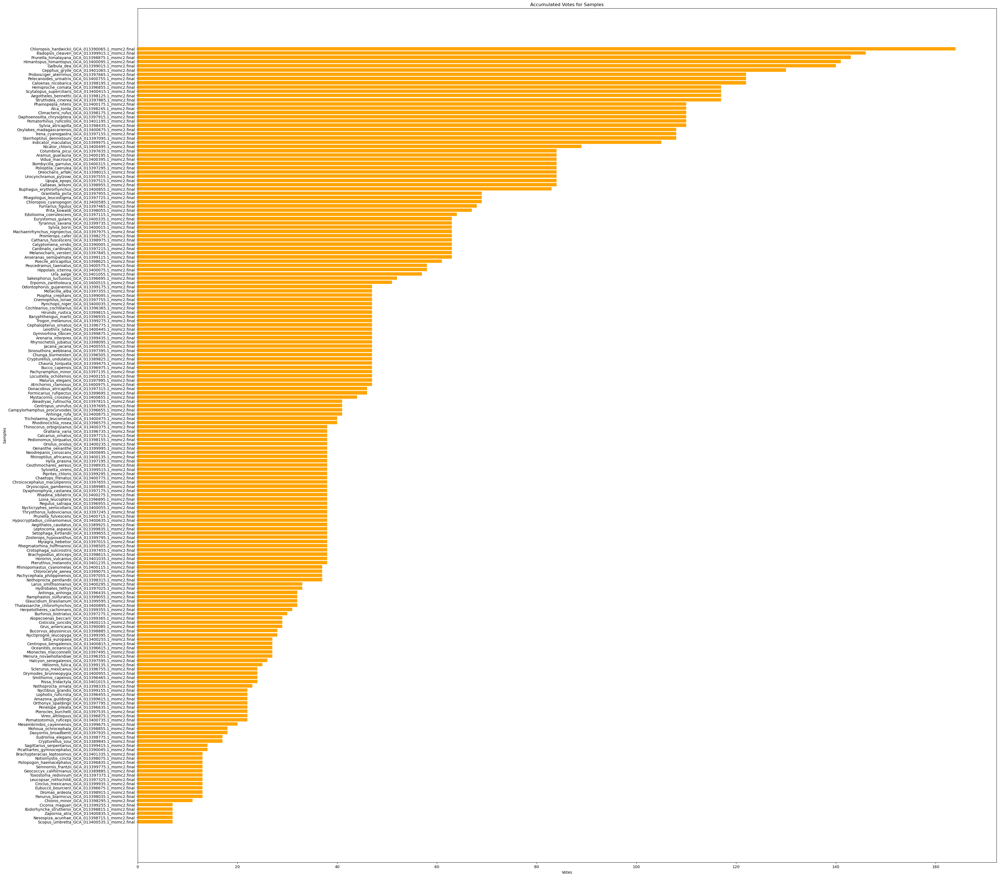

In [124]:
path = "MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/"
save_accumulation_fig_to = path+"accumulation_fig.png"
gamma = 0.0
gammas = [gamma]
clust = 8
clusts = [clust]
oldSeeds = [501, 502]
seedsList = [[8, 1],
             [2, 3]]
finalOmits = omit_test_lenient.copy() # finalOmits should add cutoff_last*len(oldSeeds)
finalOmitsAccumulated = omit_test_lenient.copy() 

# due to nature of sampling, len(oldSeeds) == len(seedsList) 
# cutoff_last = 5 # Number of samples to cutoff for each badVoteCount iteration
# 2 versions of finalOmits, 1) with updates for every newSeed, oldSeed comparison
# 2) with updates after accumulating all votes for every newSeed, oldSeed comparison
finalOmits, finalOmitsAccumulated = findVotedOutSamples(path=path,
                                                        algo="kmeans",
                                                        iters=50,
                                                        gammas=gammas,
                                                        clusts=clusts,
                                                        oldSeeds=oldSeeds,
                                                        seedsList=seedsList,
                                                        cutoff_last=5,
                                                        cutoff_lastAccumulated=10,
                                                        finalOmits=finalOmits,
                                                        finalOmitsAccumulated=finalOmitsAccumulated,
                                                        accumulate=False,
                                                        bothIncrementalAccumulative=True,
                                                        plot_everything=True,
                                                        save_accumulation_fig_to=save_accumulation_fig_to,
                                                        save_all=True)

In [121]:
# len(finalOmitsAccumulated)
len(finalOmits)

65

In [136]:
path

'MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/'

In [145]:
'''
Trying to functionify the ARI testing
'''
oldSeed = 999
# seeds = [100, 200, 300, 400, 500, 600, 700, 800, 900, 901,
#          102, 201, 301, 401, 501, 601, 701, 801, 902, 553,
#          812, 212, 313, 414, 513, 616, 717, 818, 929, 522]
seeds = [100, 200]
def runARItesting(path,
                  iters,
                  gammas,
                  clusts,
                  oldSeed,
                  seeds,
                  omitListToTest,
                  accumulative=False):
    '''
    omitListToTest is ideally made from iterative or accumulative voting.
    
    Runs |seeds| number of clusters for comparison against oldSeed cluster to
    find some distribution of the ARIs given when using an omit list
    (omitListToTest).
    '''
    status = "ACCUMULATIVE" if accumulative else "ITERATIVE"
    print("TESTING", status, "OMIT LIST")
    gamma = gammas[0]
    clust = clusts[0]
    omitListToTest = list(set(omitListToTest))
    if accumulative:
        ARI_test_dict_path = path + f"finalARI_test_dict_oldSeed{oldSeed}_Accumulative.pkl"
        badVoteCount_path = path + f"finalbadVote_oldSeed{oldSeed}_Accumulative.pkl"
        badVoteCountFig_path = path + f"finalbadVoteFig_oldSeed{oldSeed}_Accumulative.png"
        additionalOmitsPath = path + f"additionalOmissions/omitListToTest_oldSeed{oldSeed}_Accumulative.txt"
        writeListPath = path+"omitLisTested_Accumulative.txt"
        final_ARI_df2csvPath = path + "final_ARIs_Accumulative.csv"
        boxplotSavePath = path + "final_ARI_boxplot_Accumulative.png"
    else: 
        ARI_test_dict_path = path + f"finalARI_test_dict_oldSeed{oldSeed}.pkl"
        badVoteCount_path = path + f"finalbadVote_oldSeed{oldSeed}.pkl"
        badVoteCountFig_path = path + f"finalbadVoteFig_oldSeed{oldSeed}.png"
        additionalOmitsPath = path + f"additionalOmissions/omitListToTest_oldSeed{oldSeed}.txt"
        writeListPath = path+"omitLisTested.txt"
        final_ARI_df2csvPath = path + "final_ARIs.csv"
        boxplotSavePath = path + "final_ARI_boxplot.png"
    ARI_consistency_test_dict = ARI_consistency_test(algo=algo,
                                                     to_omit=omitListToTest,
                                                     iters=iters,
                                                     gammas=gammas,
                                                     clusts=clusts,
                                                     oldSeed=oldSeed,
                                                     newSeeds=seeds,
                                                     save_to=ARI_test_dict_path)
    # Call this, but I don't think anything needs to be saved
    badVoteCounter(ARI_consistency_test_dict,
                   clust,
                   oldSeed,
                   seeds,
                   gamma=gamma,
                   savefig_to=badVoteCountFig_path,
                   savepkl_to=badVoteCount_path)

    writeList(save_to=writeListPath, inlist=omitListToTest)
    ARI_consistency_test_dict[gamma][2]
    randi_dict = ARI_consistency_test_dict[gamma][2]  # list of ARIs sampled
    df = pd.DataFrame.from_dict(randi_dict)
    df = df.rename(columns={clust : "ARIs"})
    df.to_csv(final_ARI_df2csvPath)
    box_plot = sns.boxplot(x=df["ARIs"])
    if accumulative:
        plt.title("ARI Distribution of Accumulative Omit List")
    else:
        plt.title("ARI Distribution of Iterative Omit List")
    fig = box_plot.get_figure()
    fig.savefig(boxplotSavePath)
    return df

In [143]:
import seaborn as sns

TESTING ITERATIVE OMIT LIST
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 173,
mySeries: 173
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (173, 63, 2)
Computed dists of shape: (173, 173)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 173
label len: 173
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 173,
mySeries: 173
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (173, 63, 2)
Computed dists of shape: (173, 173)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 173
label len: 173
[RAND INDEX]: Random seed comparison of 8 clusters: 0.4992970783702418
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 173,
mySeries: 173


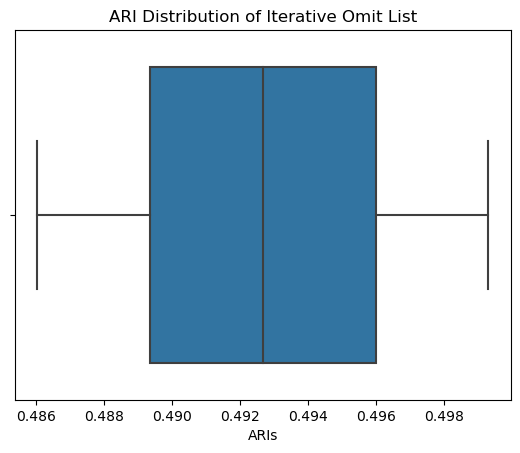

In [146]:
df = runARItesting(path=path,
                  iters=iters,
                  gammas=gammas,
                  clusts=clusts,
                  oldSeed=oldSeed,
                  seeds=seeds,
                  omitListToTest=finalOmits,
                  accumulative=False)

In [ ]:
runARItesting(path=path,
                  iters=iters,
                  gammas=gammas,
                  clusts=clusts,
                  oldSeed=oldSeed,
                  seeds=seeds,
                  omitListToTest=finalOmitsAccumulated,
                  accumulative=True)

Flipped the switch
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


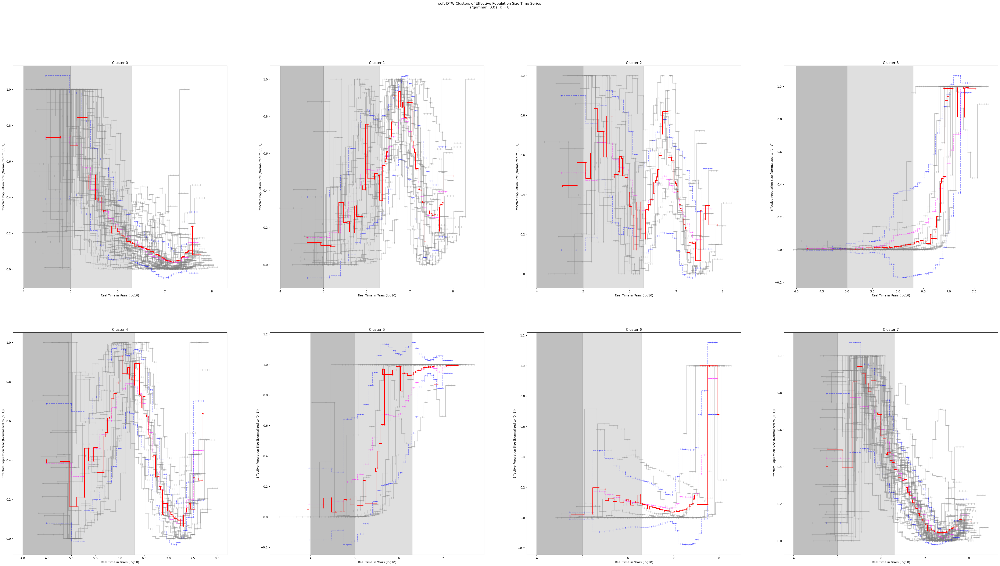

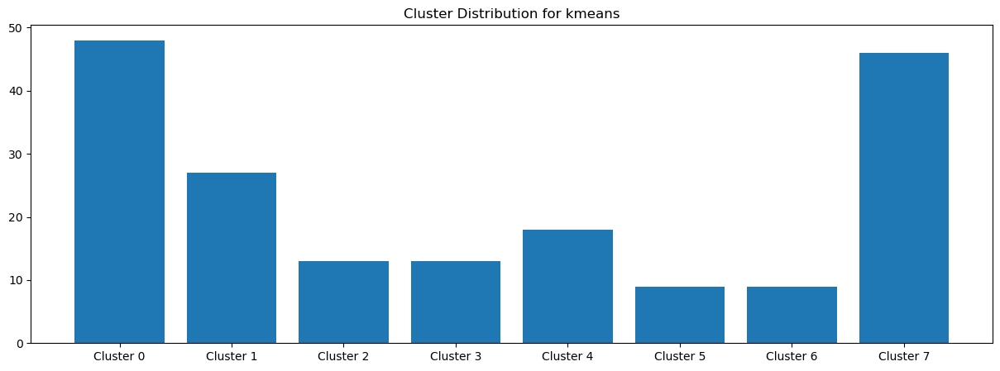

fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


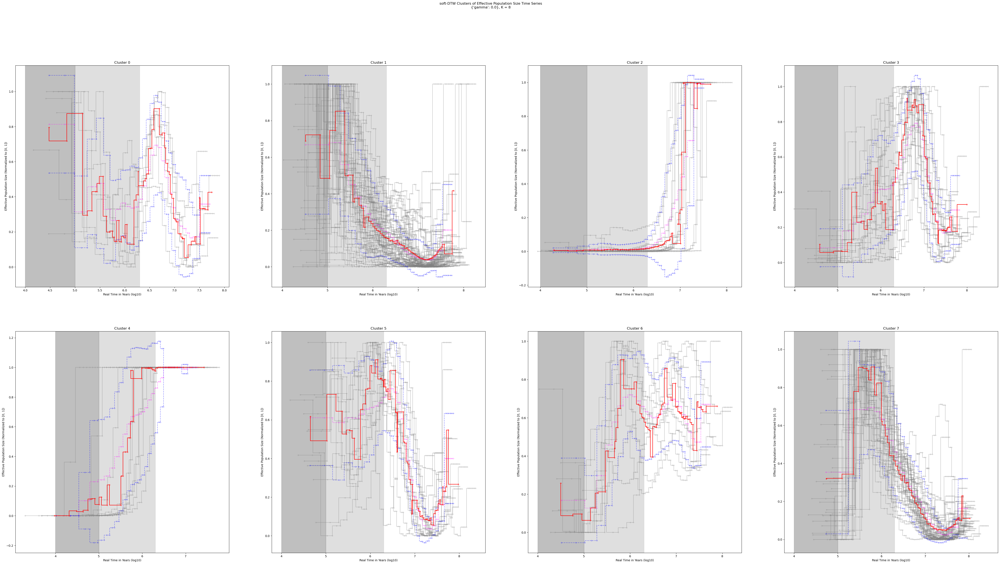

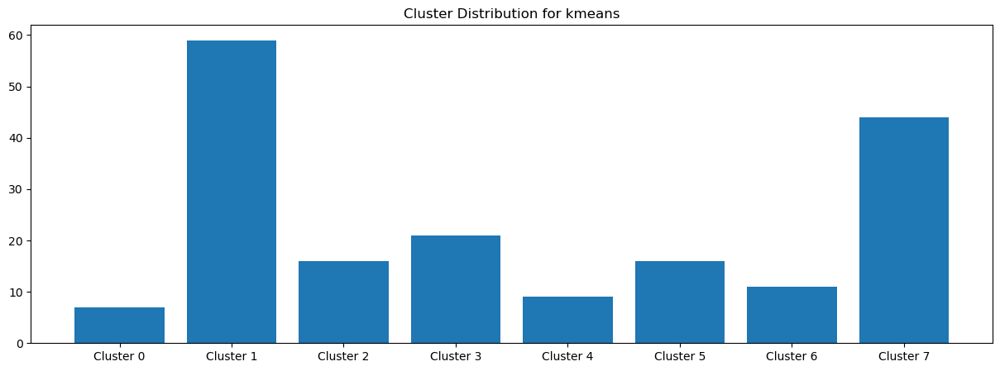

[RAND INDEX]: Random seed comparison of 8 clusters: 0.6540403166051507
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


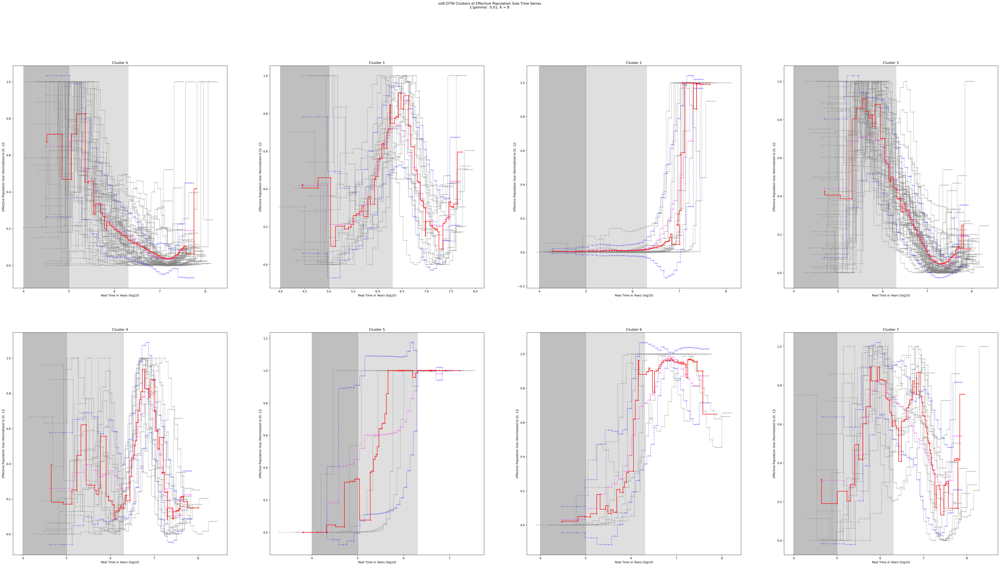

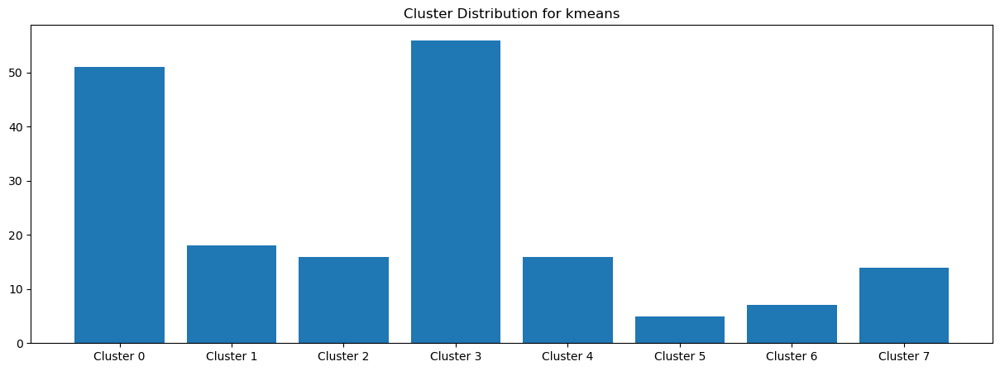

[RAND INDEX]: Random seed comparison of 8 clusters: 0.6256321486628573
TOADDDICT
MADE NEWOMIT COUNTS
MAKE FRESH COPY
MADE ACCUMULATIONS
Both
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


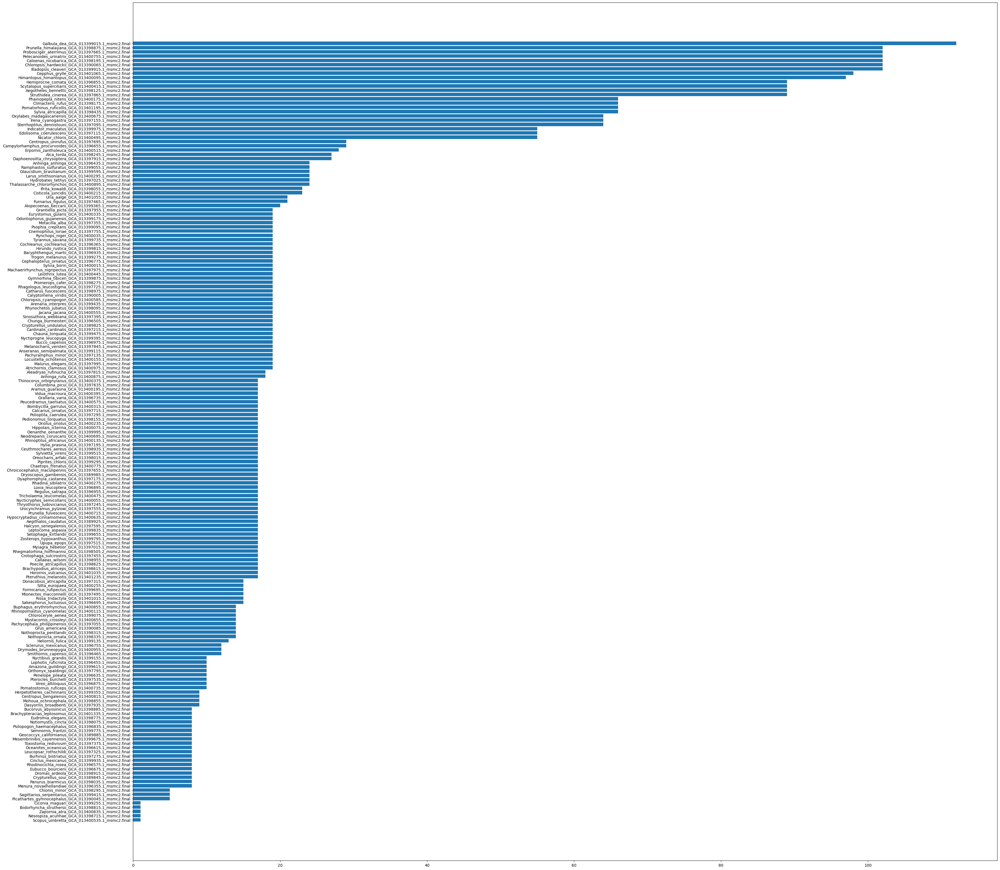

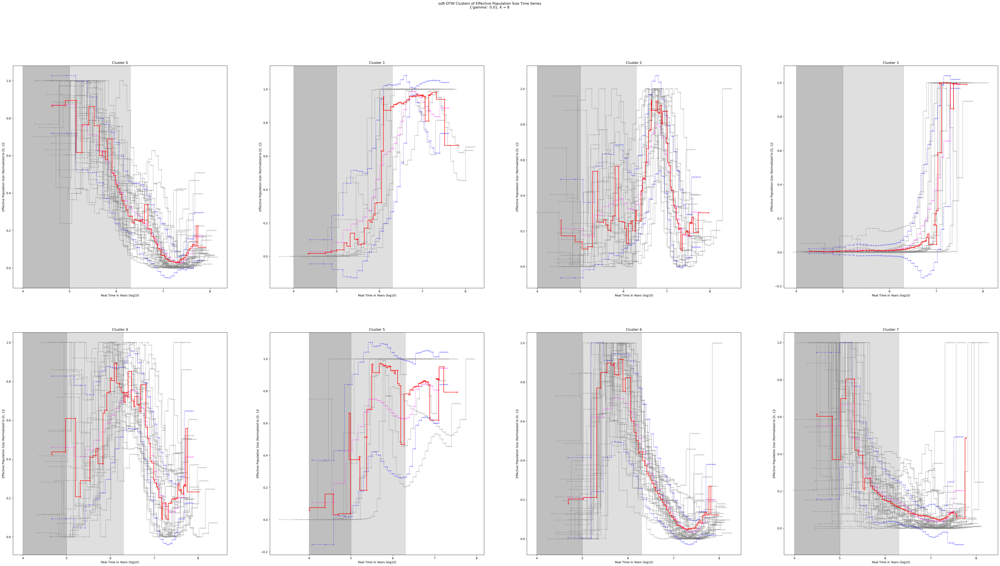

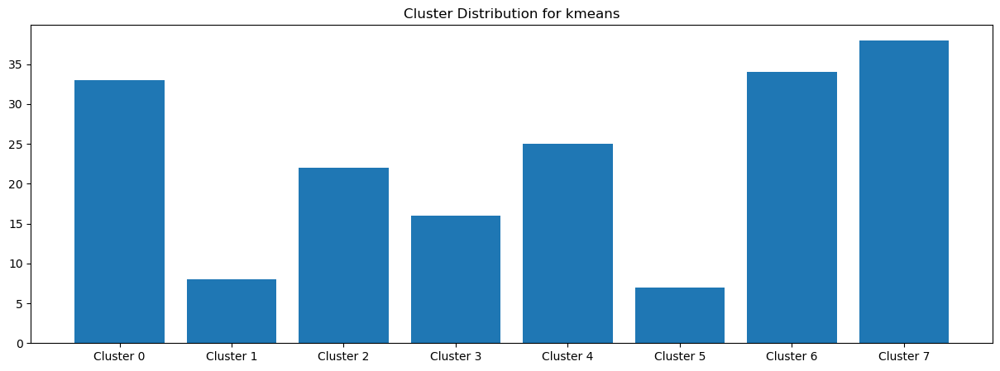

fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


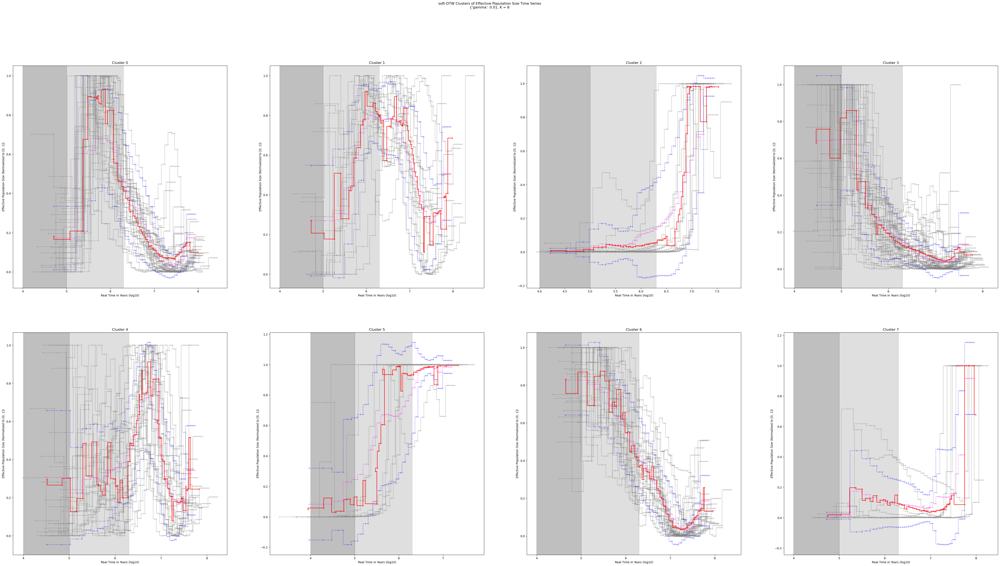

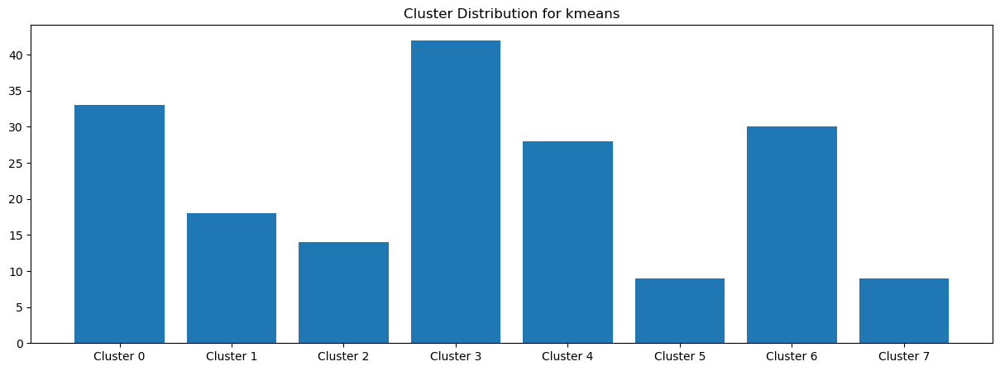

[RAND INDEX]: Random seed comparison of 8 clusters: 0.5733483020991363
fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0
cleanSeries_with_df: 183,
mySeries: 183
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (183, 63, 2)
Computed dists of shape: (183, 183)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 183
label len: 183
num to plot : 8
curve cluster plot shape: (2, 4)


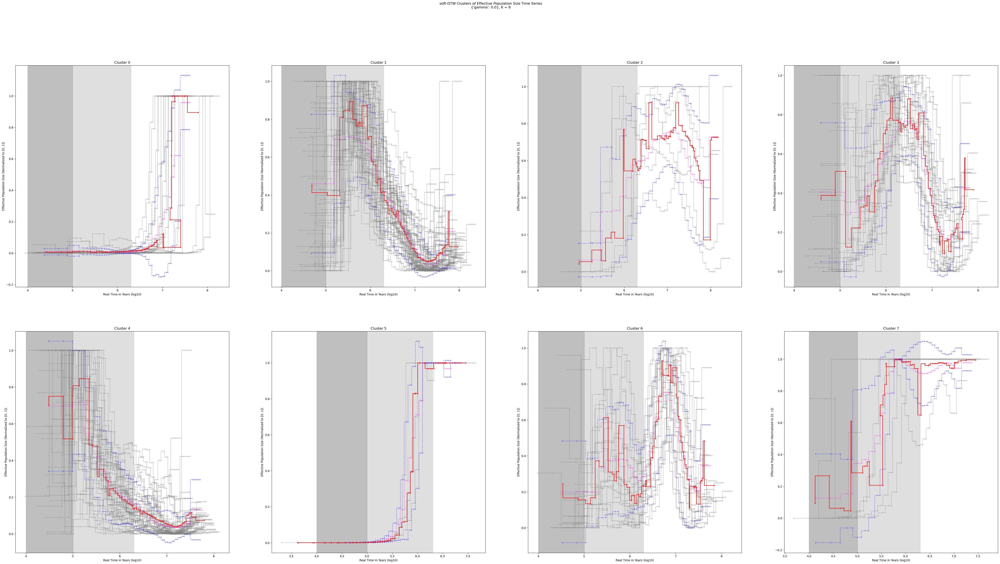

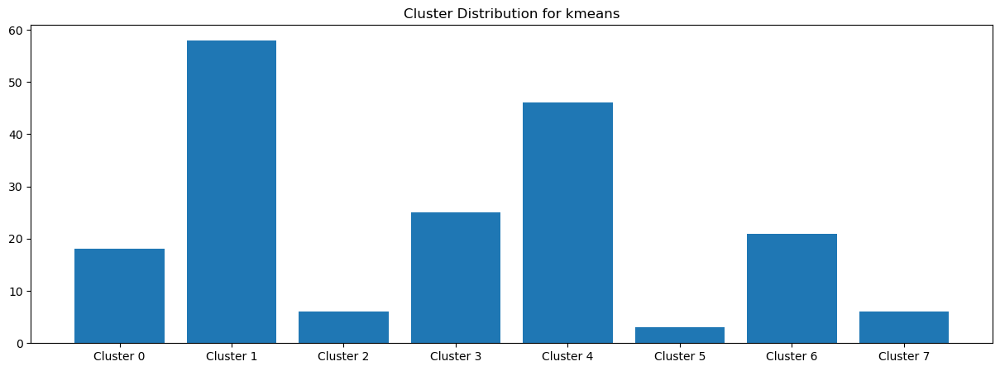

[RAND INDEX]: Random seed comparison of 8 clusters: 0.5751784245534589
TOADDDICT
MADE NEWOMIT COUNTS
NO NEED TO COPY
MADE ACCUMULATIONS
Both


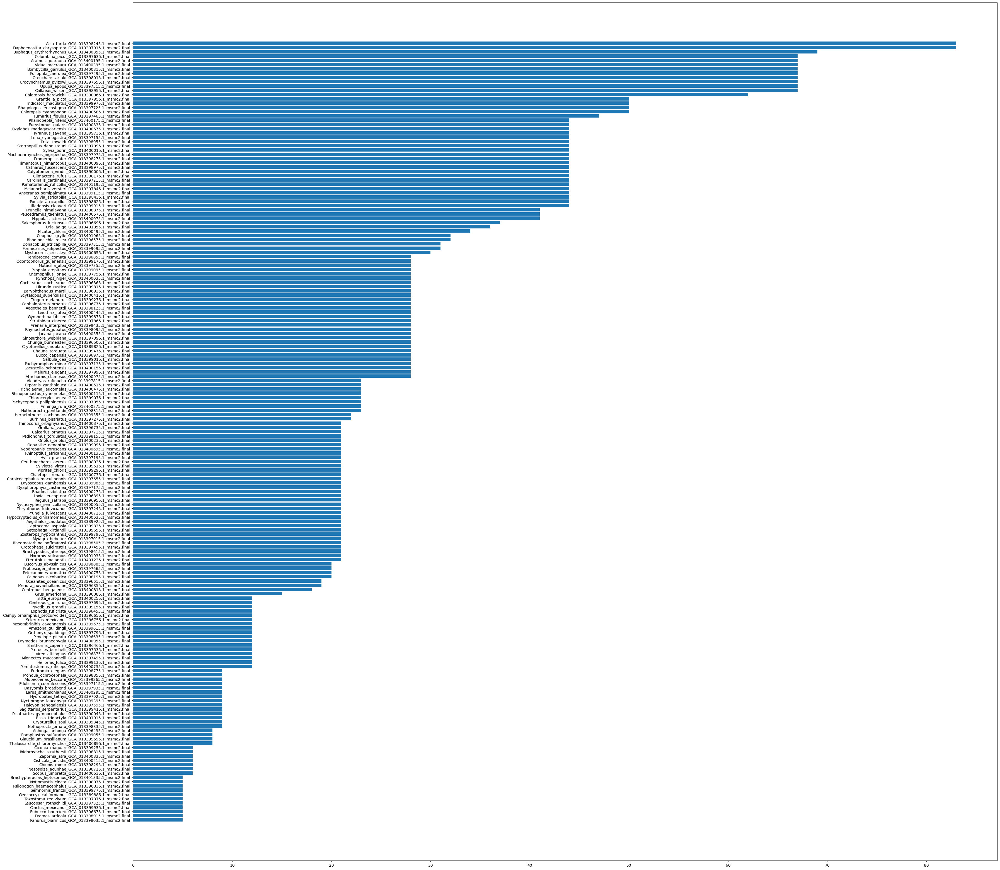

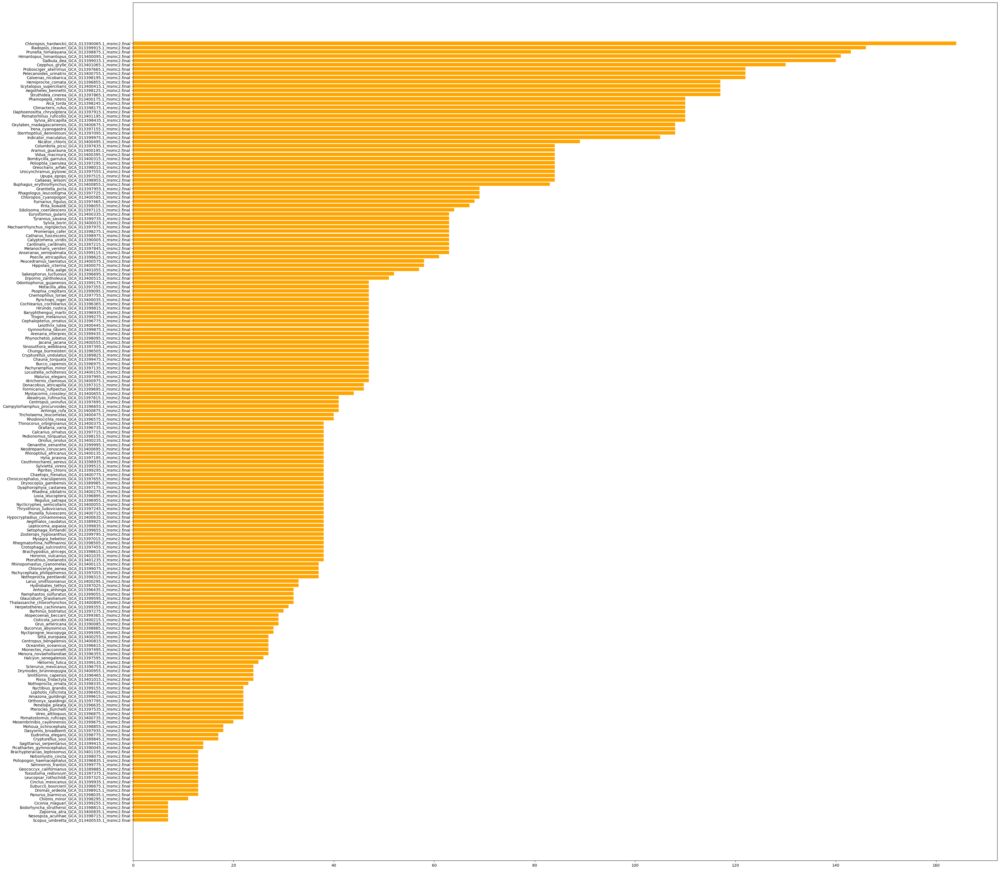

In [80]:

'''
Reliability testing: now a script on mermaid (ariTesting.py)
(MAKE ANOTHER SCIRPT)

REWORK: This uses accumulateVotes function which replaces voteOutMovingSample. 
Doing this makes it so that you don't remove samples with every
oldSeed, newSeed comparison. Instead you accumulate votes over all comparisons
and cutoff some number of the worst votes at the end.
'''

path = "MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/"
algo = "kmeans"
iters = 50
gamma = 0.0
gammas = [gamma]
clust = 8
clusts = [clust]
# due to nature of sampling, len(oldSeeds) == len(seedsList) 
oldSeeds = [501, 502]
seedsList = [[8, 1],
             [2, 3]]
cutoff_last = 5 # Number of samples to cutoff for each badVoteCount iteration
cutoff_lastAccumulated = 1
# 2 versions of finalOmits, 1) with updates for every newSeed, oldSeed comparison
# 2) with updates after accumulating all votes for every newSeed, oldSeed comparison
finalOmits = omit_test_lenient.copy() # finalOmits should add cutoff_last*len(oldSeeds)
finalOmitsAccumulated = omit_test_lenient.copy() 
accumulate = True
both = True
plot_everything = True



if both:
    print("Flipped the switch")
    accumulate = False

toAddDict = dict()
for idx, oldSeed in enumerate(oldSeeds):
    seeds = seedsList[idx]
    ARI_test_dict_path = path + f"ARI_test_dict_oldSeed{oldSeed}.pkl"
    ARI_consistency_test_dict = ARI_consistency_test(algo="kmeans",
                                                     to_omit=omit_test_lenient,
                                                     iters=50,
                                                     gammas=gammas,
                                                     clusts=clusts,
                                                     oldSeed=oldSeed,
                                                     newSeeds=seeds,
                                                     save_to=ARI_test_dict_path,
                                                     plot_everything=plot_everything)
    badVoteCount_path = path + f"badVote_oldSeed{oldSeed}.pkl"
    badVoteCountFig_path = path + f"badVoteFig_oldSeed{oldSeed}.png"
    badVoteCount = badVoteCounter(ARI_consistency_test_dict,
                                  clust,
                                  oldSeed,
                                  seeds,
                                  gamma=gamma,
                                  savefig_to=badVoteCountFig_path,
                                  savepkl_to=badVoteCount_path,
                                  plot_everything=plot_everything)
    additionalOmitsPath = path + f"additionalOmissions/ARIomits_oldSeed{oldSeed}.txt"
    if not accumulate and not both:
        if save_all:
            save_to = False
        else: 
            save_to = path + f"additionalOmissions/finalARIomits_oldSeed{oldSeed}.txt"
        newOmit = voteOutMovingSample(badVoteCount,
                                      cutoff_last=cutoff_last,
                                      save_to=save_to)
        finalOmits += newOmit
    elif accumulate and not both:
        print("TOADDDICT")
        toAddDict = voteOutMovingSample(toAddDict=toAddDict,
                                        badVoteCount=badVoteCount,
                                        accumulate=accumulate)
    elif both:
        print("TOADDDICT")
        
        pair = voteOutMovingSample(toAddDict=toAddDict,
                                   badVoteCount=badVoteCount,
                                   cutoff_last=cutoff_last,
                                   save_to=save_to,
                                   both=both)
        newOmit, toAddDict = pair
        finalOmits += newOmit
if not accumulate or both:
    x, y = zip(*sorted(list(toAddDict.items()), key=lambda x:x[1]))
    if plot_everything:
        fig = plt.figure(figsize = (40, 40))
        plt.title("Accumulated Votes for Samples")
        plt.xlabel("Votes")
        plt.ylabel("Samples")
        plt.barh(x, y, color="orange")
    finalOmitsAccumulated = x[-cutoff_lastAccumulated:]

In [72]:
sorted(list(badVoteCount.items()), key=lambda x:x[1])

[('Panurus_biarmicus_GCA_013398035.1_msmc2.final', 5),
 ('Dromas_ardeola_GCA_013398915.1_msmc2.final', 5),
 ('Eubucco_bourcierii_GCA_013396675.1_msmc2.final', 5),
 ('Cinclus_mexicanus_GCA_013399935.1_msmc2.final', 5),
 ('Leucopsar_rothschildi_GCA_013397325.1_msmc2.final', 5),
 ('Toxostoma_redivivum_GCA_013397375.1_msmc2.final', 5),
 ('Geococcyx_californianus_GCA_013389885.1_msmc2.final', 5),
 ('Semnornis_frantzii_GCA_013399775.1_msmc2.final', 5),
 ('Psilopogon_haemacephalus_GCA_013396835.1_msmc2.final', 5),
 ('Notiomystis_cincta_GCA_013398075.1_msmc2.final', 5),
 ('Brachypteracias_leptosomus_GCA_013401335.1_msmc2.final', 5),
 ('Scopus_umbretta_GCA_013400535.1_msmc2.final', 6),
 ('Nesospiza_acunhae_GCA_013398715.1_msmc2.final', 6),
 ('Chionis_minor_GCA_013398295.1_msmc2.final', 6),
 ('Cisticola_juncidis_GCA_013400215.1_msmc2.final', 6),
 ('Zapornia_atra_GCA_013400835.1_msmc2.final', 6),
 ('Ibidorhyncha_struthersii_GCA_013398815.1_msmc2.final', 6),
 ('Ciconia_maguari_GCA_013399255.1_msmc

In [73]:
sorted(list(toAddDict.items()), key=lambda x:x[1])

[('Scopus_umbretta_GCA_013400535.1_msmc2.final', 7),
 ('Nesospiza_acunhae_GCA_013398715.1_msmc2.final', 7),
 ('Zapornia_atra_GCA_013400835.1_msmc2.final', 7),
 ('Ibidorhyncha_struthersii_GCA_013398815.1_msmc2.final', 7),
 ('Ciconia_maguari_GCA_013399255.1_msmc2.final', 7),
 ('Chionis_minor_GCA_013398295.1_msmc2.final', 11),
 ('Panurus_biarmicus_GCA_013398035.1_msmc2.final', 13),
 ('Dromas_ardeola_GCA_013398915.1_msmc2.final', 13),
 ('Eubucco_bourcierii_GCA_013396675.1_msmc2.final', 13),
 ('Cinclus_mexicanus_GCA_013399935.1_msmc2.final', 13),
 ('Leucopsar_rothschildi_GCA_013397325.1_msmc2.final', 13),
 ('Toxostoma_redivivum_GCA_013397375.1_msmc2.final', 13),
 ('Geococcyx_californianus_GCA_013389885.1_msmc2.final', 13),
 ('Semnornis_frantzii_GCA_013399775.1_msmc2.final', 13),
 ('Psilopogon_haemacephalus_GCA_013396835.1_msmc2.final', 13),
 ('Notiomystis_cincta_GCA_013398075.1_msmc2.final', 13),
 ('Brachypteracias_leptosomus_GCA_013401335.1_msmc2.final', 13),
 ('Picathartes_gymnocephalus_G

Text(0, 0.5, 'Samples')

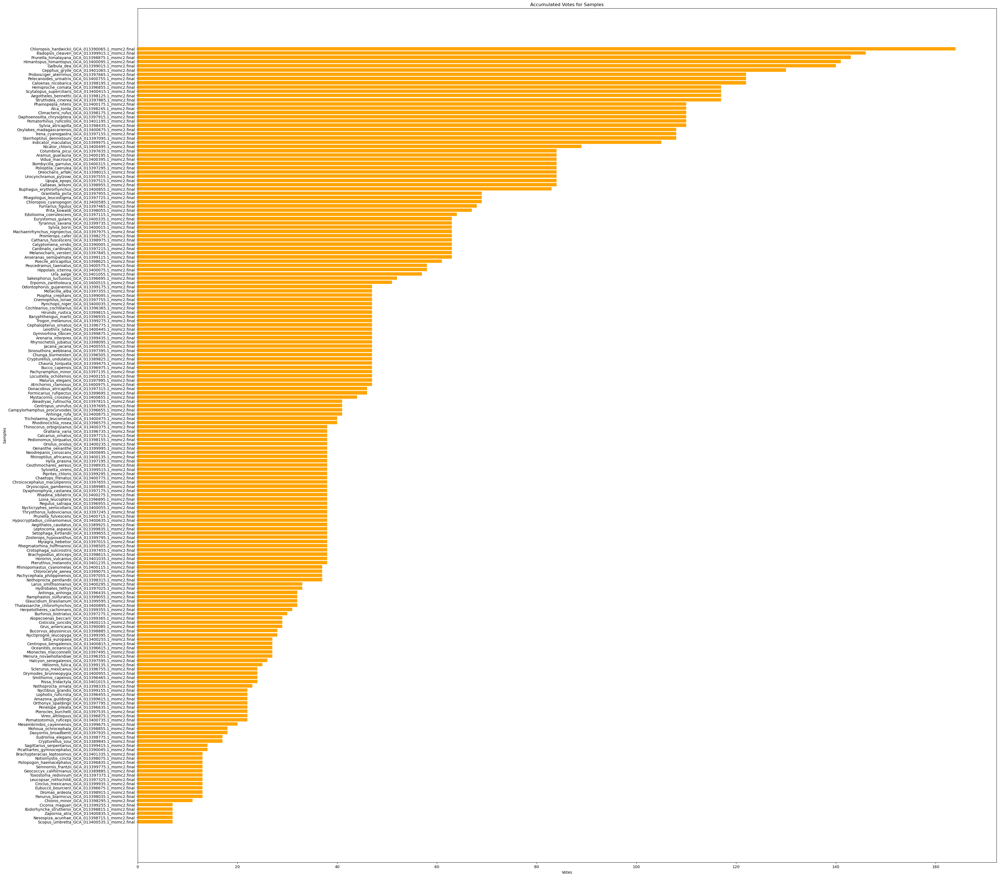

In [81]:
    x, y = zip(*sorted(list(toAddDict.items()), key = lambda x:x[1]))
    fig = plt.figure(figsize = (40, 40))
    plt.barh(x, y, color="orange")
    plt.title("Accumulated Votes for Samples")
    plt.xlabel("Votes")
    plt.ylabel("Samples")

In [ ]:
'''
Reliability testing: now a script on mermaid (ariTesting.py)
'''

path = "MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/"
algo = "kmeans"
iters = 50
gamma = 0.0
gammas = [gamma]
clust = 8
clusts = [clust]
# due to nature of sampling, len(oldSeeds) == len(seedsList) 
# oldSeeds = [502, 511]
# seedsList = [[8, 1],
#              [2, 3]]
# oldSeeds = [502, 111, 234, 454]
# seedsList = [[810, 564, 588, 155,  72, 321, 322, 909, 797, 777],
#              [134, 555, 665, 345, 123, 811, 561, 581, 151,  71],
#              [808, 667, 788, 551,  23, 114, 515, 615, 315, 113],
#              [335, 213,  34, 444, 443, 838, 627, 718, 511, 423],
#              [202, 101, 303, 505, 506, 345, 215, 554, 455, 446]]
cutoff_last = 5 # Number of samples to cutoff for each badVoteCount iteration
oldSeeds = [502, 111, 234, 454]
seedsList = [[810, 564, 588, 155,  72],
             [134, 555, 665, 345, 123],
             [808, 667, 788, 551,  23],
             [335, 213,  34, 444, 443],
             [202, 101, 303, 505, 506],
             [321, 322, 909, 797, 777],
             [811, 561, 581, 151,  71],
             [114, 515, 615, 315, 113],
             [838, 627, 718, 511, 423],
             [345, 215, 554, 455, 446],
             [232, 131, 333, 535, 536],
             [341, 342, 949, 747, 737]]
finalOmits = omit_test_lenient.copy() # finalOmits should add cutoff_last*len(oldSeeds)
for idx, oldSeed in enumerate(oldSeeds):
    seeds = seedsList[idx]
    ARI_test_dict_path = path + f"ARI_test_dict_oldSeed{oldSeed}.pkl"
    ARI_consistency_test_dict = ARI_consistency_test(algo="kmeans",
                                                     to_omit=omit_test_lenient,
                                                     iters=50,
                                                     gammas=gammas,
                                                     clusts=clusts,
                                                     oldSeed=oldSeed,
                                                     newSeeds=seeds,
                                                     save_to=ARI_test_dict_path)
    badVoteCount_path = path + f"badVote_oldSeed{oldSeed}.pkl"
    badVoteCountFig_path = path + f"badVoteFig_oldSeed{oldSeed}.png"
    badVoteCount = badVoteCounter(ARI_consistency_test_dict,
                                  clust,
                                  oldSeed,
                                  seeds,
                                  gamma=gamma,
                                  savefig_to=badVoteCountFig_path,
                                  savepkl_to=badVoteCount_path)
    additionalOmitsPath = path + f"additionalOmissions/ARIomits_oldSeed{oldSeed}.txt"
    newOmit = voteOutMovingSample(badVoteCount,
                                  cutoff_last=cutoff_last,
                                  save_to=additionalOmitsPath)
    finalOmits += newOmit


In [ ]:
# Now we need to test the ARIs of finalOmits as a to_omit list
finalOmits = list(set(finalOmits))
oldSeed = 999
seeds = [100, 200, 300, 400, 500, 600, 700, 800, 900, 901,
         102, 201, 301, 401, 501, 601, 701, 801, 902, 553,
         812, 212, 313, 414, 513, 616, 717, 818, 929, 522]
ARI_test_dict_path = path + f"finalARI_test_dict_oldSeed{oldSeed}.pkl"
ARI_consistency_test_dict = ARI_consistency_test(algo="kmeans",
                                                 to_omit=finalOmits,
                                                 iters=50,
                                                 gammas=gammas,
                                                 clusts=clusts,
                                                 oldSeed=oldSeed,
                                                 newSeeds=seeds,
                                                 save_to=ARI_test_dict_path)
badVoteCount_path = path + f"finalbadVote_oldSeed{oldSeed}.pkl"
badVoteCountFig_path = path + f"finalbadVoteFig_oldSeed{oldSeed}.png"
badVoteCount = badVoteCounter(ARI_consistency_test_dict,
                              clust,
                              oldSeed,
                              seeds,
                              gamma=gamma,
                              savefig_to=badVoteCountFig_path,
                              savepkl_to=badVoteCount_path)
additionalOmitsPath = path + f"additionalOmissions/finalARIomits_oldSeed{oldSeed}.txt"
newOmit = voteOutMovingSample(badVoteCount,
                              cutoff_last=cutoff_last,
                              save_to=additionalOmitsPath)

ARI_consistency_test_dict[gamma][2]
randi_dict = ARI_consistency_test_dict[gamma][2] # list of ARIs sampled
df = pd.DataFrame.from_dict(randi_dict)
df = df.rename(columns={clust:"ARIs"})
sns.boxplot(x=df["ARIs"])
plt.savefig(path + "final_ARI_boxplot.png")


In [ ]:
df = pd.read_csv(path + "batches_20_trials_10/" + "final_ARIs.csv")

In [ ]:
box_plot = sns.boxplot(x=df["ARIs"])
fig = box_plot.get_figure()
fig.savefig(path + "final_ARI_boxplot2.png")

In [ ]:
df

In [ ]:
def ARITestSeedGenerator(oldSeedNum, newSeedNum):
    '''
    oldSeedMum specifies number of seeds to use as reference in comparisons 
    between a reference and newSeedNum amount of other clusterings.
    '''
    oldSeeds = list(np.random.randint(low=1, high = 9999, size=oldSeedNum))
    seedsList = [list(np.random.randint(low=1, high = 9999, size=newSeedNum))
                 for i in range(len(oldSeeds))]
    return oldSeeds, seedsList

In [ ]:
testSeeds, _ = ARITestSeedGenerator(30, 1)
testSeeds

In [ ]:
path = "MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/"
ariOmitList = readList(path + "batches_40_trials_20_cutoff_last_5/finalOmitsList.txt")

In [68]:
seeds = [234, 345, 456, 567, 123, 6543]
seeds = [234]
rows = 2
fs_x = 64
fs_y = 7 * rows
for seed in seeds:
    clustering_new = Msmc_clustering(directory="msmc_curve_data/", 
                                     mu=1.4e-9, 
                                     generation_time_path='generation_lengths/', 
                                     real_time=True, 
                                     to_omit=ariOmitList,
                                     normalize_lambda=True, 
                                     log_scale_time=True, 
                                     plot_on_log_scale=True, 
                                     exclude_subdirs=["Archive", "mammals_part_1"], 
                                     manual_cluster_count=8,
                                     algo="kmeans") # cluster count by sqrt method is 14
    clustering_new.cluster_curves(omit_front=0, 
                              omit_back=0, 
                              cols=4,  
                              fs_x=fs_x, 
                              fs_y=fs_y,
                              metric_params={"gamma" : 0.0},
                              metric="dtw",
                              random_state=seed,
                              plot_everything=True,
                              iter=50)

NameError: name 'ariOmitList' is not defined

In [ ]:
X = np.array([i.drop("right_time_boundary", axis=1).to_numpy() for i in clustering_new.mySeries])
name2label = dict()
for kvpair in clustering_new.name2series.items():
    key, val = kvpair
    X = np.array([val.drop(["right_time_boundary", axis=1]).to_numpy()])
    name2label[key] = clustering_new.km.predict(X)
labels = clustering_new.dtw_labels
# Some sort of custom normalization done by tslearn (mod of sklearn silhouette score)
# which generalizes dimension of X data
avg_silhouette_score = silhouette_score(X, labels, metric = "dtw") 
print(avg_silhouette_score)

In [ ]:
path = "MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/"
ariOmitList = readList(path + "batches_40_trials_20_cutoff_last_5.100_samples/finalOmitsList.txt")
newOmitList = [i for i in ariOmitList if i not in omit_test_lenient]
len(newOmitList)

In [ ]:
clustering = Msmc_clustering(directory="msmc_curve_data/", 
                                 mu=1.4e-9, 
                                 generation_time_path='generation_lengths/', 
                                 real_time=True, 
                                 to_omit=[],
                                 normalize_lambda=True, 
                                 log_scale_time=True, 
                                 plot_on_log_scale=True, 
                                 exclude_subdirs=["Archive", "mammals_part_1"], 
                                 manual_cluster_count=8,
                                 algo="kmeans") # cluster count by sqrt method is 14

In [ ]:
'''
Plot all samples in newOmitList
'''

In [ ]:
np.array([sample_xy]).shape

In [ ]:
idx = 1
for sample in newOmitList[:idx]:
    sample_df = clustering.name2series[sample]
    sample_xy = sample_df.drop(["right_time_boundary"], axis=1).to_numpy()
    print(np.array([sample_xy]).shape)
    predicted_label = clustering_new.km.predict(np.array([sample_xy]))
    print(predicted_label)
    x, y = zip(*sample_xy)
    plt.step(x, y)
#     plt.close()

In [ ]:
clustering_lenient = Msmc_clustering(directory="msmc_curve_data/", 
                                 mu=1.4e-9, 
                                 generation_time_path='generation_lengths/', 
                                 real_time=True, 
                                 to_omit=omit_test_lenient,
                                 normalize_lambda=True, 
                                 log_scale_time=True, 
                                 plot_on_log_scale=True, 
                                 exclude_subdirs=["Archive", "mammals_part_1"], 
                                 manual_cluster_count=8,
                                 algo="kmeans") # cluster count by sqrt method is 14
clustering_lenient.cluster_curves(omit_front=0, 
                          omit_back=0, 
                          cols=4,  
                          fs_x=fs_x, 
                          fs_y=fs_y,
                          metric_params={"gamma" : 0.0},
                          metric="dtw",
                          random_state=234,
                          plot_everything=True,
                          iter=50)

In [ ]:
# Save dict cuz it be large

import pickle
import json 

pname = "ri_test_gammas_0_0.pickle"
dict_path = "MSMC-Exploratory-Analysis/results/"
with open(dict_path + pname, 'wb') as fp:
    pickle.dump(by_gamma_dict, fp, protocol=pickle.HIGHEST_PROTOCOL)

by_gamma_dict_slim = {gamma : by_gamma_dict[gamma][2] for gamma in gammas}
fname = "ri_test_gammas_0_0_slim.json"
with open(dict_path + fname, 'w') as fp:
    json.dump(by_gamma_dict_slim, fp)

gammas = [0.0]
clustnums = [7,8,9,10,11,12,13,14]
fig, axs = plt.subplots(2,1, figsize=(12, 10))
fig.tight_layout(pad=5.0)
for gamma in gammas:
    randi_dict = by_gamma_dict_slim[gamma]
    # clustnums_ints = sorted([int(i) for i in randi_dict.keys()])
    # clustnums = sorted(list(randi_dict.keys()))
    avg_randi = [np.mean(randi_dict[clustnum]) for clustnum in clustnums]
    sd_randi =  [np.std(randi_dict[clustnum]) for clustnum in clustnums]
    var_randi = [np.var(randi_dict[clustnum]) for clustnum in clustnums]
    axs[0].set_title("Average Rand Index (5 trials each)")
    axs[0].set_xlabel("Cluster Number"                    )
    axs[0].set_ylabel("Average Rand Index Score"          )
    
    axs[0].plot(clustnums, avg_randi, '-o', label=f"Gamma = {gamma}")
    
    axs[0].legend()

    axs[1].set_title("Rand Index SD"    )
    axs[1].set_xlabel("Cluster Number"  )
    axs[1].set_ylabel("Rand Index Score")
    # axs[1].tick_params(fontsize=15)
    axs[1].plot(sd_randi, '-o', label=f"Gamma = {gamma}")
    axs[1].legend()

    # axs[2].set_title("Rand Index Var")
    # axs[2].set_xlabel("Cluster Number")
    # axs[2].set_xticks(clusts)
    # axs[2].set_ylabel("Rand Index Score")
    # axs[2].plot(var_randi, '-o', label=f"Gamma = {gamma}")
    # axs[2].legend()


# DBScan Grid Search on min_samples and epsilon

In [ ]:
'''
Best clustering method with more lenient filtering
'''
# figures_path = "MSMC-Exploratory-Analysis/results/figures/"
# kmeans_name = "kshapes_clustering.png"
# min_samples = [3,4,5,6,7,8]
# epss = np.arange(1, 8.1, .1)

min_samples = range(6, 7)
# epss = np.arange(1.5, 3, 0.05)
epss = np.arange(1.5, 2.1, 0.5)

for min_sample in min_samples:
    for eps in epss:
        print(f"min_sample: {min_sample}")
        print(f"eps       : {eps}")
        cluster_rt_dbscan = Msmc_clustering(directory="msmc_curve_data/", 
                                                mu=1.4e-9, 
                                                generation_time_path='generation_lengths/', 
                                                real_time=True, 
                                                to_omit=omit_test_lenient, 
                                                normalize_lambda=True, 
                                                log_scale_time=True, 
                                                plot_on_log_scale=True, 
                                                exclude_subdirs=["Archive", "mammals_part_1"], 
                                                manual_cluster_count=11,
                                                algo="dbscan") # cluster count by sqrt method is 14

        rows = 2
        fs_x = 64
        fs_y = 7 * rows
        cluster_rt_dbscan.cluster_curves(manual_eps = eps,
                                        min_samples=min_sample,
                                        metric="dtw",
                                        fs_x = fs_x,
                                        fs_y = fs_y)



In [ ]:
'''
Notes:
- With higher eps vals, all curves get packed into a single cluster
- Increasing min samples might be a good idea for breaking up the single massive cluster

Not bad:

min_sample: 2
eps       : 1.0500000000000003

min_sample: 2
eps       : 1.4500000000000006

min_sample: 3
eps       : 1.0

Kinda decent:

min_sample: 5
eps       : 2.0

min_sample: 4
eps       : 1.8000000000000003
'''


In [ ]:
cluster_rt_dbscan = Msmc_clustering(directory="msmc_curve_data/", 
                                        mu=1.4e-9, 
                                        generation_time_path='generation_lengths/', 
                                        real_time=True, 
                                        to_omit=omit_test_lenient, 
#                                         to_omit=newOmit,
                                        normalize_lambda=True, 
                                        log_scale_time=True, 
                                        plot_on_log_scale=True, 
                                        exclude_subdirs=["Archive", "mammals_part_1"], 
                                        algo="dbscan") # cluster count by sqrt method is 14
rows = 2
fs_x = 64
fs_y = 7 * rows
cluster_rt_dbscan.cluster_curves(manual_eps = 1.8,
                                min_samples=4,
                                metric="dtw",
                                fs_x = fs_x,
                                fs_y = fs_y)

In [ ]:
max_pw_dists_lite ,dmatrix = mc.max_pairwise_dists_of_cluster(cluster_rt_dbscan)
fig, axs = plt.subplots(1,1, figsize = (15, 15)) 
sns.heatmap(dmatrix[-1][1], ax=axs)
axs.set_xticks(np.arange(len(dmatrix[-1][2]))+0.5)
axs.set_yticks(np.arange(len(dmatrix[-1][2]))+0.5)
axs.set_xticklabels(dmatrix[-1][2], rotation=90)
axs.set_yticklabels(dmatrix[-1][2], rotation=0)
plt.show()
# print()

# Silhouette score clustering scheme test
- Cell block will compute a bunch of stuff and take a bit of time to finish
- Nested for loop O(gamma * clusternum)

In [ ]:
'''
Silhouette score clustering scheme test

Description:
Script aids in finding optimal cluster size and gamma to use for clustering based 
on silhouette scores. 

Notes:
Silhouette scores are on the range of [-1, 1] when -1 
is bad and 1 is good. Good silhouette scores reflect high between cluster separation
(high between group sum of squares) and high cluster cohesion (low bwithingn group 
sum of squares). 

Outline of program:
Script below runs clustering based on Soft-DTW with varying Gamma (soft-DTW parameter) 
and Cluster Sizes ( O(G*C) complexity ). Takes a long time to run so be patient.
'''

# path for output
silhouette_path = "MSMC-Exploratory-Analysis/results/silhouette-tests/"
# init a dict keyed by gamma-cluster number combos. Dict to be filled in from nested for loop below
avg_silhouette_score_dict = dict()
# Lists to iterate over
# gammas = list(np.arange(0.1, 0.91, 0.2))
gammas = np.array([0.0])
clusternums = list(range(2,21))

for gamma in gammas: # Iterate over gammas
    if gamma == 0.0:
        gamma_val = None
        metric_params={"gamma" : gamma_val} # tslearn soft-dtw  needs gamma param in this format
        print(metric_params, gamma)
    else:
        gamma = gamma.round(1) # Round to overcome dumb floating point error with numpy
        metric_params={"gamma" : gamma} # tslearn soft-dtw  needs gamma param in this format
        print(metric_params, gamma)
    curr_gamma_dir = f"gamma_{gamma}" # Set current gamma as a name to be used for output path
    # Part 1 of handling directories for output; Specific to gamma
    fig_gamma_path = silhouette_path + "figures/" + curr_gamma_dir # Cluster Fig path
    list_gamma_path = silhouette_path + "lists/" + curr_gamma_dir # Cluster label List/table path
    if curr_gamma_dir not in os.listdir(silhouette_path + "figures/"): # mkdir for figures corresponding to current gamma
        os.mkdir(fig_gamma_path)
    if curr_gamma_dir not in os.listdir(silhouette_path + "lists/"): # mkdir for lists corresponding to current gamma
        os.mkdir(list_gamma_path)
    for clusternum in clusternums:
    # for clusternum in range(2, 10):
        curr_clusternum_dir = f"clusternum_{clusternum}"
        save_name = f"{curr_gamma_dir}_{curr_clusternum_dir}"
        # Part 2 of handling directories for output; Specific to gamma AND clusternum
        fig_path = fig_gamma_path + '/' + curr_clusternum_dir + '/' # Path specific to gamma AND cluster num
        list_path = list_gamma_path  + '/' + curr_clusternum_dir + '/'
        if curr_clusternum_dir not in os.listdir(fig_gamma_path): # mkdir for figures corresponding to current gamma
            os.mkdir(fig_path)
        if curr_clusternum_dir not in os.listdir(list_gamma_path):
            os.mkdir(list_path)

        # print("init")
        cluster_rt_norm_lenient = Msmc_clustering(directory="msmc_curve_data/", 
                                                mu=1.4e-9, 
                                                generation_time_path='generation_lengths/', 
                                                real_time=True, 
                                                to_omit=omit_test_lenient, 
                                                normalize_lambda=True, 
                                                log_scale_time=True, 
                                                plot_on_log_scale=True, 
                                                exclude_subdirs=["Archive", "mammals_part_1"], 
                                                manual_cluster_count=clusternum) # cluster count by sqrt method is 14
        # Perform clustering and save fig
        print("clustering now")
        print("fig_path", fig_path)
        print("save_name", save_name)
        # Below code decides number of rows to achieve a 16:7 picture ratio
        cols = 4
        if clusternum%cols == 0:
            rows = (clusternum//cols)
        else:
            rows = (clusternum//cols) + 1
        fs_x = 64
        fs_y = 7 * rows
        if gamma > 0:
            metric = "soft-dtw"
        else:
            metric = "dtw"
        cluster_rt_norm_lenient.cluster_curves(omit_front=0, 
                                            omit_back=0, 
                                            cols=4,  
                                            fs_x=fs_x, 
                                            fs_y=fs_y, 
                                            metric_params=metric_params,
                                            save_to = fig_path,
                                            save_name = save_name+".png",
                                            metric = metric)
        
        # Save clustering model
        if save_name + ".hdf5" in os.listdir(list_path): # Attempt to overwrite if exists by manually deleting
            os.remove(list_path+save_name + ".hdf5")
            cluster_rt_norm_lenient.km.to_hdf5(list_path+save_name + ".hdf5")
        else:
            cluster_rt_norm_lenient.km.to_hdf5(list_path+save_name + ".hdf5")
        # Save clustering centers to numpy saved file .npy
        np.save(list_path+save_name + "_cluster_centers.npy", cluster_rt_norm_lenient.km.cluster_centers_)
        # Save clustering barycenters to numpy saved file .npy
        barycenters = []
        barycenters_final = []
        for idx, ts in cluster_rt_norm_lenient.label2barycenter.items():
            barycenters.append([idx, ts])
        for pair in barycenters:
            label = pair[0]
            xy = list(zip(pair[1][0], pair[1][1]))
            barycenters_final.append([label, np.array(xy)])
        barycenters_final = np.array(barycenters_final) # np.array (clusternum, 2), each clusternum is row is a pair of [clusternum, timeseries]
        np.save(list_path+save_name + "_cluster_barycenters.npy", barycenters_final)
        # Save curve-cluster table
        cluster_rt_norm_lenient.clusterTable.to_csv(list_path + save_name + ".tsv", sep="\t")
        X = np.array([i.drop("right_time_boundary", axis=1).to_numpy() for i in cluster_rt_norm_lenient.mySeries])
        labels = cluster_rt_norm_lenient.dtw_labels
        # Some sort of custom normalization done by tslearn (mod of sklearn silhouette score)
        # which generalizes dimension of X data
        avg_silhouette_score = silhouette_score(X, labels, metric = metric) 
        sample_silhouette_values = bootleg_silhouette_samples(X, labels, metric = metric)
        print(f"avg_silhouette_score = {avg_silhouette_score}")
        # Plot sample silhouette spectrum for current clustering
        plot_sample_silhouette_spectrum(sample_silhouette_values,
                                        clusternum,
                                        labels=labels,
                                        avg_silhouette_score,
                                        save_to=fig_path, save_name=save_name+"_sample_silhouette.png" )
        # Save sample silhoutte spectrum data
        X_names = [i for i in cluster_rt_norm_lenient.namesofMySeries]

        sample_silhouette_csvfile = list_path + save_name + "_sample_silhouette_scores.csv"
        with open(sample_silhouette_csvfile, 'w') as mf:
            for idx in range(len(X_names)):
                mf.write(f"{X_names[idx]},{labels[idx]},{sample_silhouette_values[idx]}\n")

        key = f"g{gamma} c{clusternum}"
        avg_silhouette_score_dict[key] = avg_silhouette_score
# Save avg_silhouette_score_dict as csv
import csv
csvfile = "avg_silhouette_scores.csv"
# csvfile = "avg_silhouette_scores.csv"
with open(silhouette_path + csvfile, 'w') as f:
    for key in avg_silhouette_score_dict.keys():
        f.write(f"{key},{avg_silhouette_score_dict[key]}\n")

# Silhouette Score Heatmap


In [ ]:
'''
Script generates heatmap for silhouette scores for clustering settings

might want to run clustering on sizes 2-9 with gamma 0.1-0.9 in steps of 0.2
for fuller picture of silhouette landscape
'''
# Read clustering data (Silhouette scores)
silhouette_path = "MSMC-Exploratory-Analysis/results/silhouette-tests/"
csvfile = "avg_silhouette_scores.csv"
with open(silhouette_path + csvfile, 'r') as myfile:
    df_dict = dict()
    df_cols = set()
    for line in myfile:
        key_str, val_str = line.split(",")
        X_idx_g, Y_idx_c = key_str.split(" ")
        gamma = float(X_idx_g[1:])
        clustnum = int(Y_idx_c[1:])
        if gamma not in df_dict:
            df_dict[gamma] = []
        df_dict[gamma].append(float(val_str))
        df_cols.add(clustnum)
# Create pandas df for sns heatmap input
df_silhouettes = pd.DataFrame(df_dict.values(),columns=df_cols,index=df_dict.keys()).sort_index() 
# Create heatmap
fig, ax = plt.subplots(figsize=(12, 8))
sns.heatmap(df_silhouettes)
plt.tick_params(axis='both',labelsize=12)
ax.set_xlabel("Cluster Number", fontsize=14)
ax.set_ylabel("Gamma", fontsize=14)
ax.set_title("Silhoutte Scores over Cluster Number and Gamma", fontsize=16)

# Elbow method tests
- Cell block will compute a bunch of stuff and take a bit of time to finish
- For each gamma, runs elbow method on cluster numbers 2-20

In [ ]:
'''
Elbow Method tests over gammas
'''

gammas = np.around(np.arange(.1, .91, 0.2), 1).tolist()
gammas = np.array([0.0])

elbow_path = "MSMC-Exploratory-Analysis/results/silhouette-tests/"

# Part 1 of handling directories for output
fig_path = elbow_path + "figures/" # Cluster Fig path
list_path = elbow_path + "lists/" # Cluster label List/table path

for gamma in gammas:
    curr_clusternum_dir = f"gamma_{gamma}"
    save_name = f"gamma_{gamma}_elbow_plot.png"
    save_name_csv = f"gamma_{gamma}_elbow_plot_data.csv"
    cluster_rt_norm_lenient = Msmc_clustering(directory="msmc_curve_data/", 
                                            mu=1.4e-9, 
                                            generation_time_path='generation_lengths/', 
                                            real_time=True, 
                                            to_omit=omit_test_lenient, 
                                            normalize_lambda=True, 
                                            log_scale_time=True, 
                                            plot_on_log_scale=True, 
                                            exclude_subdirs=["Archive", "mammals_part_1"]) # cluster count by sqrt method is 14
    # Perform clustering and save fig
    print("clustering now")
    print("fig_path", fig_path)
    print("save_name", save_name)
    if gamma == 0.0:
        gammaval = None
    else:
        gamma = gammaval
    cluster_rt_norm_lenient.elbow_method(gamma=gammaval, save_name = save_name, save_to = fig_path + curr_clusternum_dir + "/")
    df = pd.DataFrame(cluster_rt_norm_lenient.elbow_data, columns = ['n_clusters', 'inertia']) # save this way bc im lazy
    df.to_csv(list_path + curr_clusternum_dir + "/" + save_name_csv)

# Elbow + Silhouette Score Method
- Makes use of a knee finding algo to find knees in elbow curves
- Uses the Elbow curve knees as a lower bound since the Elbow method indicates the point where most change stops

In [ ]:
main_path = "MSMC-Exploratory-Analysis/results/silhouette-tests/"


# gammas = np.array([0.0])
# gamma = 0.1
# Elbow data gathering
list_path = main_path + "lists/"
# Example path to an elbow plot of gamma_0.1 over cluster numbers 2-19:
# elbow_path = main_path + "lists/gamma_0.1/gamma_0.1_elbow_plot_data.csv"
elbow_df_name = "elbow_inertia_scores.csv"
if elbow_df_name not in os.listdir(main_path):
    elbow_data = []
    gammas = os.listdir(list_path)
    # print(gammas)
    for gamma in gammas: # gamma will be a str f"gamma_{x}" where x is a gamma value
        gamma_value = gamma.split("_")[1] # String slicey time
        elbow_path = list_path + f"gamma_{gamma_value}/gamma_{gamma_value}_elbow_plot_data.csv"
        elbow_data.append(pd.read_csv(elbow_path))
    cluster_nums = elbow_data[0].drop('Unnamed: 0', axis=1).to_numpy()[:,0].tolist() # Retrieve cluster numbers from any elbow dataset
    cluster_nums = [f"cnum_{x}" for x in cluster_nums]
    # Construct a df where rows are gamma, cols are cluster numbers, and vals are inertias
    # os.listdir(list_path)
    elbow_df = pd.DataFrame(columns=cluster_nums, index = gammas) # (gammas, cluster_numbers) with vals = inertias
    for idx, data in enumerate(elbow_data):
        elbow_df.loc[gammas[idx]] = elbow_data[idx]["inertia"].to_numpy()
    elbow_df.to_csv(main_path + elbow_df_name)
else:
    elbow_df = pd.read_csv(main_path + elbow_df_name, index_col=0)
    cluster_nums = elbow_df.columns.to_list() # Retrieve cluster numbers from any elbow dataset


# Silhouette data gathering 
gammas = [0.0, 0.1, 0.3, 0.5, 0.7, 0.9]
silhouette_data_path = main_path + "avg_silhouette_scores.csv"
silhouette_df_name = "silhouette_scores.csv"
if silhouette_df_name not in os.listdir(main_path):
    silhouette_data = pd.read_csv(silhouette_data_path, header=None)  # data in csv is dim ~ (gammas, cluster_nums)
    gamma_names = [f"gamma_{gamma}" for gamma in gammas]
    silhouette_df = pd.DataFrame(columns=cluster_nums, index = gamma_names)
    # Code to "nicify" original icky silhouette score data 
    cg = silhouette_data[0].to_list() # gamma keys
    ss = silhouette_data[1].to_list() # cnum keys
    for idx, cg_entry in enumerate(cg):
        gamma, cnum = cg_entry.split(" ")
        gamma = gamma.replace("g", "gamma_")
        cnum = cnum.replace("c", "cnum_")+".0"
        silhouette_df[cnum].loc[gamma] = ss[idx]
    silhouette_df.to_csv(main_path + silhouette_df_name)
else:
    silhouette_df = pd.read_csv(main_path + silhouette_df_name, index_col=0)


In [ ]:
'''
My proposal, we:
(1) Use Elbow method to find the cluster number where changes begin to drop off
(2) Then we use Silhouette Score to fine tune our selection as we should be choosing the cluster number which maximizes Sil. Score
    - Sil. Scores are really high with small cluster numbers though, likely because of the nature of the shapes of time series data

Ref.
[1] kneed package https://pypi.org/project/kneed/
[2] Deciding with Elbow, Eval with Silhoette https://towardsdatascience.com/silhouette-or-elbow-that-is-the-question-a1dda4fb974
[3] Roles of Elbow and Silhouettes https://vitalflux.com/elbow-method-silhouette-score-which-better/#:~:text=The%20elbow%20method%20is%20used,cluster%20or%20across%20different%20clusters.
'''


gammas = [0.0, 0.1, 0.3, 0.5, 0.7, 0.9]
fig, axs = plt.subplots(nrows = 2, ncols = 6, figsize=(40,8))
for col, gamma in enumerate(gammas):
    # Rely on elbow to choose the left boundary
    # Find Elbow knee point
    x = np.arange(2,21,1)
    y_elbow = elbow_df.loc[f"gamma_{gamma}"].to_numpy()
    kneedle_elbow = kneed.KneeLocator(x, y_elbow, S=1.0, curve="convex", direction="decreasing")
    # kneedle_elbow.plot_knee_normalized() # Helps visualize changes between points
    knee_point_elbow = kneedle_elbow.knee #elbow_point = kneedle.elbow
    axs[0][col].set_title(f"Gamma = {gamma}")
    axs[0][col].plot(x, y_elbow, "-o")
    axs[0][col].set_ylabel("Inertia (Within Group SSE)")
    axs[0][col].axvline(x = knee_point_elbow, color = 'r', label = 'axvline - full height')

    # Find Silhouette knee point
    y_silhouette = silhouette_df.loc[f"gamma_{gamma}"].to_numpy()
    kneedle_silhouette = kneed.KneeLocator(x[knee_point_elbow:], y_silhouette[knee_point_elbow:], S=1.0, curve="concave", direction="increasing")
    # kneedle_silhouette.plot_knee_normalized() # Helps visualize changes between points
    # Plot Silhouette
    knee_point_silhouette = kneedle_silhouette.knee #silhouette_point = kneedle.silhouette
    print(knee_point_silho?uette)
    axs[1][col].plot(np.arange(2,21,1), y_silhouette, "-o")
    axs[1][col].axvline(x = knee_point_silhouette, color = 'r', label = 'axvline - full height')
    axs[1][col].set_ylabel("Silhouette Score")
    axs[1][col].set_xlabel("Cluster Number")

elbow_fig_path = "MSMC-Exploratory-Analysis/results/silhouette-tests/figures/"
fig.savefig(elbow_fig_path + "Elbow+Silhouette_overview.png", dpi=300)

# Inertia + Silhouette Score Plots 
- Align vertically (Inertia on top)
- X-axis will be cluster numbers (In common)

## Inertias
- Y-axis will be Within Group SSE (Inertia) 

## Silhouette Scores
- Y-axis will be Silhouette Score

# Distance Matrix Analysis

- Using default settings to analyze distance matrix created
- NOTE: Clustering is not required, just read in time series data and send it 
with the `soft_dtw()` function

In [ ]:
clustering = Msmc_clustering(directory="msmc_curve_data/", 
                                          mu=1.4e-9, 
                                          generation_time_path='generation_lengths/', 
                                          real_time=True, 
                                          to_omit=omit_test_lenient, 
                                          normalize_lambda=True, 
                                          log_scale_time=True, 
                                          plot_on_log_scale=True, 
                                          exclude_subdirs=["Archive", "mammals_part_1"], 
                                          manual_cluster_count=9,
                                          algo="kmeans") # cluster count by sqrt method is 14

In [ ]:
# Initialize distance matrix
# Normalize the curves
from tslearn.metrics import soft_dtw 
names = clustering.namesofMySeries
data = clustering.mySeries # For clustered models can use clustering.clustering_data

distance_matrix = np.zeros((len(data), len(data)))
for idx, i in enumerate(data):
    for jdx, j in enumerate(data):
        # Calculate pairwise distances using dynamic time warping
        distance  = soft_dtw(i.drop(labels=["right_time_boundary"], axis=1).to_numpy(), 
                             j.drop(labels=["right_time_boundary"], axis=1).to_numpy(), gamma=0)
        distance_matrix[idx][jdx] = distance
        distance_matrix[jdx][idx] = distance
print(distance_matrix)

In [ ]:
DF = pd.DataFrame(distance_matrix)
DF
# save the dataframe as a csv file
DF.to_csv(silhouette_path+"distance_matrix_c_num_is_9.csv")

In [ ]:
DF = pd.DataFrame(names)
DF
# save the dataframe as a csv file
DF.to_csv(silhouette_path+"ordered_names_for_distance_matrix_c_num_is_9.csv")

In [ ]:
sns.heatmap(distance_matrix)

In [ ]:
distance_matrix.argmax(axis=1)